
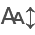

In [106]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
import upsetplot
import textwrap
from io import StringIO
import seaborn as sns
from collections import namedtuple
import missingno as msno
from itables import show
from itables import init_notebook_mode
from scipy.stats import pearsonr
import json
import scipy.stats as stats
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import (
    MaxAbsScaler,
    MinMaxScaler,
    Normalizer,
    PowerTransformer,
    QuantileTransformer,
    RobustScaler,
    StandardScaler,
    minmax_scale,
)
from sklearn.model_selection import train_test_split, GridSearchCV, RandomizedSearchCV
from sklearn import tree, metrics
from sklearn.utils.multiclass import unique_labels
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import make_multilabel_classification
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import balanced_accuracy_score, accuracy_score, precision_score, recall_score, f1_score
from sklearn.utils.class_weight import compute_sample_weight
import xgboost as xgb

import pydotplus
from IPython.display import Image

# Set the maximum number of rows and columns displayed
pd.set_option('display.max_rows', 250)
pd.set_option('display.max_columns', 250)

# Set options for itables
init_notebook_mode(all_interactive=True)

%matplotlib inline

To view interactive components from github, click this link:

https://nbviewer.org/github/deannachurch/SBCapstone_CRISPRScreens/blob/main/notebooks/ModelingAndEvaluation.ipynb

# Overview

This notebook is for evaluating model building to predict gene essentiality. We must apply 2-3 models to this problem, and evaluate the performance of these models. 

The target variable is called 'Annotation' and it has 3 possible values: Essential, Non-essential and Uncharacterized. 

This is a multi-label classification problem, with class imbalance. 

I will test the following classification models:

* Simple Decision Tree
* Random Forest 
* XGBoost

Per the conversation with my mentor, I will use this notebook to code the target variable. 

The use of the decision tree based methods means we don't need to scale data as we did in the Feature Processing notebook.

I will also do a bit of correlation analysis and feature optimization, in addition to hyperparameter tuning and evaluation. 

# Functions

In [107]:
def calculate_ratio(df, num, denom, name):
    """ 
    Calculate the ratio of two columns in a dataframe

    Parameters: 
        df (pd.DataFrame): dataframe on which to operate
        num: column name of the numerator
        denom: column name of the denominator
        name: name of new column

    Returns:
        pd.DataFrame: Updated dataframe with the added ratio column
    """
    # Data validation
    if not isinstance(df, pd.DataFrame):
        raise TypeError("df should be a pandas DataFrame")
    if num not in df.columns:
        raise KeyError(f"{num} not a column name in df")
    if denom not in df.columns:
        raise KeyError(f"{denom} not a column name in df")
    if not pd.api.types.is_numeric_dtype(df[num]):
        raise TypeError(f"num column is not numeric")
    if not pd.api.types.is_numeric_dtype(df[denom]):
        raise TypeError(f"denom column is not numeric")
    
    df[name] = df[num]/df[denom]

    return df

In [108]:
def create_plot_confusion_matrix(y_test, y_pred, title, binary='no'):
    """
    Create a confusion matrix for the gene essentiality classifiers. 

    Parameters:
        y_test: test data (true labels)
        y_pred: predicted data (prediction labels)
        title: plot title

    Returns:
        fig
    """

    # Define the mapping from numerical values to string labels
    if binary == 'yes':
        label_mapping = {0: 'NonEssential', 1: 'Essential'}
        class_labels = ['Essential', 'NonEssential']
    else: 
        label_mapping = {-1: 'Uncategorized', 0: 'NonEssential', 1: 'Essential'}
        class_labels = ['Essential', 'NonEssential', 'Uncategorized']

    # Map the numerical values to string labels
    y_test_mapped = y_test.map(label_mapping)
    y_pred_mapped = pd.Series(y_pred).map(label_mapping)

    # Calculate the confusion matrix
    conf_matrix = metrics.confusion_matrix(y_test_mapped, y_pred_mapped)

    # Get the unique class labels
    

    # Plot the confusion matrix
    fig = plt.figure(figsize=(10, 7))
    sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
    plt.xlabel('Predicted Labels')
    plt.ylabel('True Labels')
    plt.title(title)

    return fig

In [109]:
def aggregate_reps(df, col_name, col_list):
    """
    aggregate replicate information into one variable- aggregate the columns based using median. Can update if we need this to be more general

    Parameters:
        dataframe
        list of columns to aggregate

    Returns:
        dataframe
    """
    # Ensure the columns to aggregate are present in the DataFrame
    for col in col_list:
        if col not in df.columns:
            raise KeyError(f"Column '{col}' not found in DataFrame.")
    
    # Aggregate the specified columns by their mean
    df[col_name] = df[col_list].mean(axis=1)
    return df

# Preprocessing

- [X] Read in data
- [X] Select only trac2 data (there are two data sets, we can us trac1 as an additional test set)
- [X] Plot some values to see if we can see a separation of values
- [X] Code target variable
- [X] Look at correlation
- [X] Make test,train splits

In [110]:
# Read in data

full_df=pd.read_csv('../data/processed/brunello_trac2_gene_level_data.csv')
show(full_df)

In [111]:
# will calculate ratios of various attributes. Probably OK to do on full dataframe (before splitting) as this is a per row operation and should not lead to any data leakage.
full_df=calculate_ratio(full_df, 'Tx Length', 'Target Exon_min', 'TargetEx2TxLength')
show(full_df)

In [112]:
# Rename columns
full_df.rename(columns={'A375 mean': 'cell_exp_mean', 'A375 median': 'cell_exp_median', 'A375 std_dev': 'cell_exp_std_dev',
                        'trac2_pDNA_CPM_mean': 'start_count_mean', 'trac2_pDNA_CPM_median': 'start_count_median',
                        'trac2_pDNA_CPM_std': 'start_count_std'}, inplace=True)

# Display the updated dataframe
show(full_df.head())

In [113]:
# Calculate the median of the three specified columns for each row- take the median for each value
mean_list=['trac2_RepA_CPM_mean', 'trac2_RepB_CPM_mean', 'trac2_RepC_CPM_mean']
med_list=['trac2_RepA_CPM_median', 'trac2_RepB_CPM_median', 'trac2_RepC_CPM_median']
std_list=['trac2_RepA_CPM_std', 'trac2_RepB_CPM_std', 'trac2_RepC_CPM_std']
diff_mean_list=['trac2_A_diff_mean', 'trac2_B_diff_mean', 'trac2_C_diff_mean']
diff_med_list=['trac2_A_diff_median', 'trac2_B_diff_median', 'trac2_C_diff_median']
diff_std_list=['trac2_A_diff_std', 'trac2_B_diff_std', 'trac2_C_diff_std']

full_df=aggregate_reps(full_df, 'Rep_CPM_mean', mean_list)
full_df=aggregate_reps(full_df, 'Rep_CPM_median', med_list)
full_df=aggregate_reps(full_df, 'Rep_CPM_std', std_list)
full_df=aggregate_reps(full_df, 'Diff_mean', diff_mean_list)
full_df=aggregate_reps(full_df, 'Diff_median', diff_med_list)
full_df=aggregate_reps(full_df, 'Diff_std', diff_std_list)


# Display the updated dataframe
show(full_df.head())

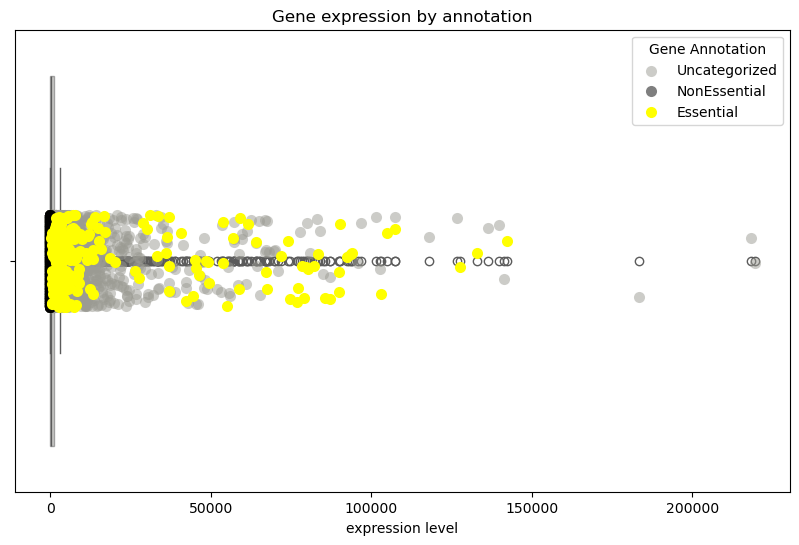

In [114]:
# Set up the figure
plt.figure(figsize=(10, 6))

# Create the boxplot
sns.boxplot(x='cell_exp_mean', data=full_df, color="#9B9B93", boxprops=dict(alpha=0.5))

# Create the stripplot for Uncategorized
sns.stripplot(x='cell_exp_mean', data=full_df[full_df['Annotation'] == 'Uncategorized'], color='#9B9B93', alpha=0.5, jitter=True, size=8, label='Uncategorized')

# Create the stripplot for NonEssential
sns.stripplot(x='cell_exp_mean', data=full_df[full_df['Annotation'] == 'NonEssential'], color='black', alpha=0.5, jitter=True, size=8, label='NonEssential')

# Create the stripplot for Essential with larger dots
sns.stripplot(x='cell_exp_mean', data=full_df[full_df['Annotation'] == 'Essential'], color='yellow', alpha=1, jitter=True, size=8, label='Essential')

# Set the title and labels
plt.title('Gene expression by annotation')
plt.xlabel('expression level')
plt.ylabel('')

# Show the legend
plt.legend(title='Gene Annotation', loc='upper right')

# Show the plot
plt.show()

In [9]:
# Calculate the decile for the start_count_mean column
#full_df['start_count_mean_decile'] = pd.qcut(full_df['start_count_mean'], 10, labels=False) + 1
#full_df['exp_mean_decile'] = pd.qcut(full_df['cell_exp_mean'], 10, labels=False) + 1

# Display the updated dataframe
#show(full_df.head())

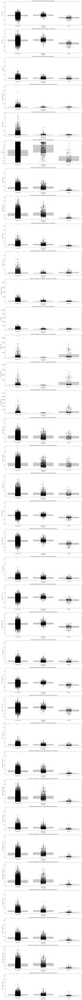

In [10]:
# List of numerical columns excluding 'Target Gene ID'
numerical_columns = full_df.select_dtypes(include=[np.number]).columns.tolist()
numerical_columns.remove('Target Gene ID')
numerical_columns.sort()

# Set up the figure
fig, axes = plt.subplots(len(numerical_columns), 1, figsize=(15, 5 * len(numerical_columns)))

# Plot each numerical column
for i, col in enumerate(numerical_columns):
    sns.boxplot(x='Annotation', y=col, data=full_df, ax=axes[i], color="#9B9B93", boxprops=dict(alpha=0.5))
    sns.stripplot(x='Annotation', y=col, data=full_df, ax=axes[i], color='black', alpha=0.5, jitter=True)
    axes[i].set_title(f'Boxplot and Stripplot of {col} by Annotation')

plt.tight_layout()
plt.show()

In [11]:
#now drop individual columns
full_df = full_df.drop(columns=full_df.filter(regex='^trac2_').columns)
show(full_df)

# Observations

There are definitely some features that seem to differentiate Essential from NonEssential genes. it is hard to know about the Uncategorized due to the class imbalance. There are almost certainly some 'essential' genes in this bin. We'll have to see how this impacts model building. But, there are clearly substantial overlap in many categories of interest between 'Essential' and 'NonEssential'

In [12]:
full_df['Annotation'].value_counts()

Annotation
Uncategorized    18050
NonEssential       858
Essential          207
Name: count, dtype: int64

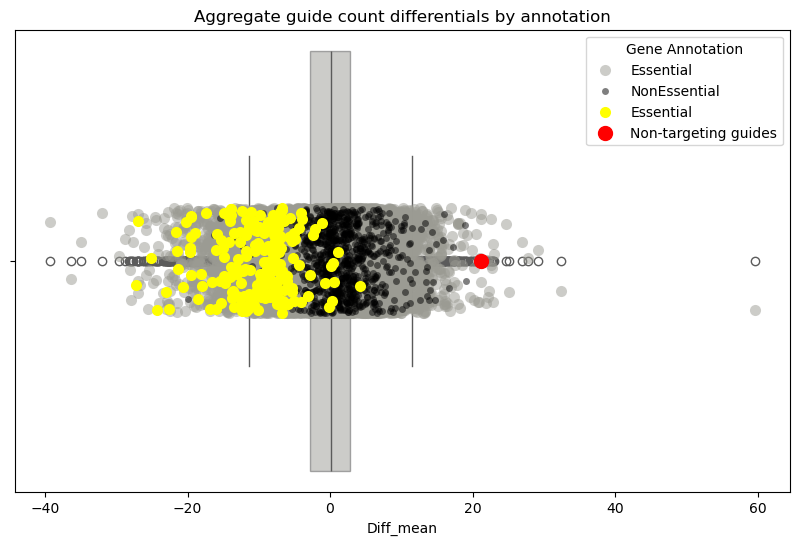

In [13]:
# Set up the figure
plt.figure(figsize=(10, 6))

# Create the boxplot
sns.boxplot(x='Diff_mean', data=full_df, color="#9B9B93", boxprops=dict(alpha=0.5))

#uncategorized
sns.stripplot(x='Diff_mean', data=full_df[full_df['Annotation'] == 'Uncategorized'], color='#9B9B93', alpha=0.5, jitter=True, size=8, label='Essential')

# Create the stripplot for correct=True
sns.stripplot(x='Diff_mean', data=full_df[full_df['Annotation'] == 'NonEssential'], color='black', alpha=0.5, jitter=True, label='NonEssential')

# Create the stripplot for correct=False with larger dots
sns.stripplot(x='Diff_mean', data=full_df[full_df['Annotation'] == 'Essential'], color='yellow', alpha=1, jitter=True, size=8, label='Essential')

# Highlight the points where 'Target Gene ID' == 0 in red
target_gene_id_0 = full_df[full_df['Target Gene ID'] == 0]
plt.scatter(x=target_gene_id_0['Diff_mean'], y=[0] * len(target_gene_id_0), color='red', s=100, label='Non-targeting guides', zorder=5)

# Set the title and labels
plt.title('Aggregate guide count differentials by annotation')
plt.xlabel('Diff_mean')
plt.ylabel('')

# Show the legend
plt.legend(title='Gene Annotation', loc='upper right')

# Show the plot
plt.show()

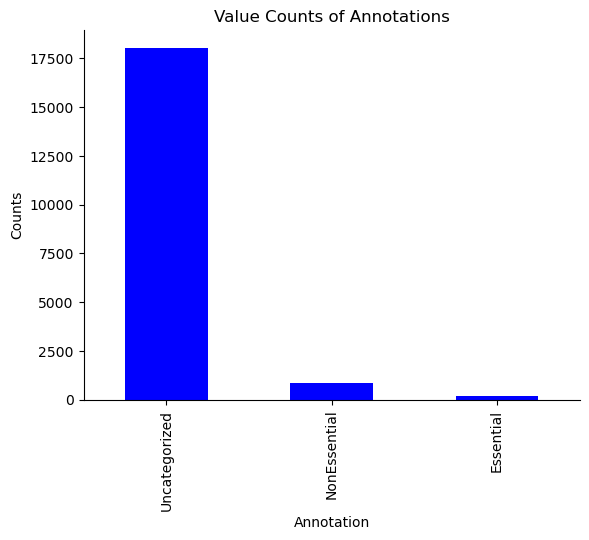

In [14]:
# Plot the value counts of the 'Annotation' column as a bar chart
full_df['Annotation'].value_counts().plot(kind='bar', color='blue')

# Set the title and labels
plt.title('Value Counts of Annotations')
plt.xlabel('Annotation')
plt.ylabel('Counts')
sns.despine(top=True, right=True)

# Show the plot
plt.show()

In [15]:
# Convert 'Annotation' column to numerical values
annotation_mapping = {'Uncategorized': -1, 'NonEssential': 0, 'Essential': 1}
full_df['Annotation'] = full_df['Annotation'].map(annotation_mapping)
# Display the updated dataframe
show(full_df['Annotation'].value_counts())

In [16]:
#just noticed I need to correct the NaN in TargetEx2TxLenth
full_df['TargetEx2TxLength']=full_df['TargetEx2TxLength'].fillna(0)
full_df.isna().sum()

Target Gene ID        0
start_count_mean      0
start_count_median    0
start_count_std       1
Target Exon_min       0
Tx Length             0
Gene Isoform Count    0
Gene Length           0
cell_exp_mean         0
cell_exp_median       0
cell_exp_std_dev      0
LOEUF                 0
Annotation            0
TargetEx2TxLength     0
Rep_CPM_mean          0
Rep_CPM_median        0
Rep_CPM_std           1
Diff_mean             0
Diff_median           0
Diff_std              1
dtype: int64

In [17]:
# Print rows with any null values
null_rows = full_df[full_df.isnull().any(axis=1)]
show(null_rows)

In [18]:
#fill remaining null values with 0
full_df = full_df.fillna(0)
full_df.isna().sum()

Target Gene ID        0
start_count_mean      0
start_count_median    0
start_count_std       0
Target Exon_min       0
Tx Length             0
Gene Isoform Count    0
Gene Length           0
cell_exp_mean         0
cell_exp_median       0
cell_exp_std_dev      0
LOEUF                 0
Annotation            0
TargetEx2TxLength     0
Rep_CPM_mean          0
Rep_CPM_median        0
Rep_CPM_std           0
Diff_mean             0
Diff_median           0
Diff_std              0
dtype: int64

In [19]:
# Make 'Target Gene ID' the index for full_df
full_df=full_df.set_index('Target Gene ID')
display(full_df.head())

start_count_mean  start_count_median  start_count_std  \
Target Gene ID                                                          
0                      24.108509           21.822172        11.244953   
1                      17.875609           16.540742        15.530696   
2                      16.018403           15.960365         9.752635   
9                       9.634257            8.821729         3.558804   
10                     14.306291           15.147838         4.394926   

                Target Exon_min  Tx Length  Gene Isoform Count  Gene Length  \
Target Gene ID                                                                
0                           0.0        0.0                 0.0          0.0   
1                           5.0     1766.0                 1.0       8310.0   
2                           6.0     4678.0                 6.0      48522.0   
9                           3.0     1821.0                16.0      53223.0   
10                          2.0     1317.0                 3.0      14918.0   

                cell_exp_mean  cell_exp_median  cell_exp_std_dev  LOEUF  \
Target Gene ID                                                            
0                  358.969758       285.511030        203.822522  1.000   
1                   51.445406        41.893863         32.394602  1.340   
2                    7.214316         2.056853         12.621402  0.765   
9                  214.403118       188.216225        121.047907  1.906   
10                  11.046498         2.205915         13.919940  1.938   

                Annotation  TargetEx2TxLength  Rep_CPM_mean  Rep_CPM_median  \
Target Gene ID                                                                
0                       -1           0.000000     45.236552       40.857384   
1                       -1         353.200000     20.024226       22.023506   
2                       -1         779.666667     15.348150       12.232372   
9                       -1         607.000000     14.267247       15.463907   
10                      -1         658.500000     18.517362       17.788426   

                Rep_CPM_std  Diff_mean  Diff_median   Diff_std  
Target Gene ID                                                  
0                 26.076604  21.128043    18.882942  20.024842  
1                 15.507755   2.148616     2.248093  12.937153  
2                 13.250003  -0.670253     1.147748  12.607520  
9                  5.539459   4.632990     4.597146   4.220292  
10                10.404249   4.211071     3.537586   9.766199

In [20]:
# Make X, y variables
X_full = full_df.drop(columns=['Annotation']).copy()
y_full = full_df['Annotation'].copy()
show(X_full.head())
show(y_full.head())

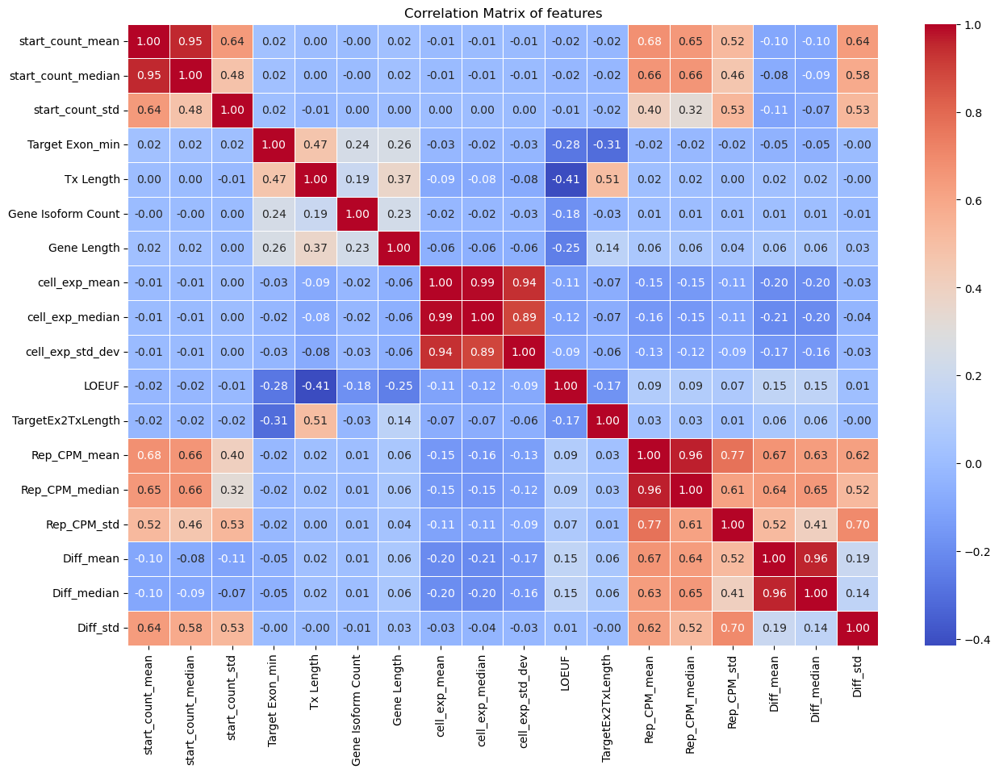

In [21]:
# Calculate the correlation matrix
corr_matrix = X_full.corr()

# Set up the matplotlib figure
plt.figure(figsize=(15, 10))

# Draw the heatmap with the correlation matrix
sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap='coolwarm', linewidths=0.5)

# Set the title
plt.title('Correlation Matrix of features')

# Show the plot
plt.show()

# Observations

Most of the correlated features are:

* groups of mean, median and std for guide counts and expression
* count replicates (these should be correlated)
* the std of the diffs does not correlate as well as it does for the plain count mean and median.

Note: don't need to scale data due to the use of decision trees, ensemble methods or XGboost

In [22]:
# test, train splits
X_train, X_test, y_train, y_test = train_test_split(X_full, y_full, test_size=0.2, random_state=42)

print(f"X train: {X_train.shape}")
print(f"X test: {X_test.shape}")

print(f"Annotation full: {full_df['Annotation'].value_counts()} {full_df['Annotation'].value_counts(normalize=True) * 100}%")
print(f"Annotation split (train): {y_train.value_counts()} {y_train.value_counts(normalize=True) * 100}%")
print(f"Annotation split (test) {y_test.value_counts()} {y_test.value_counts(normalize=True) * 100}%")

X train: (15292, 18)
X test: (3823, 18)
Annotation full: Annotation
-1    18050
 0      858
 1      207
Name: count, dtype: int64 Annotation
-1    94.428459
 0     4.488622
 1     1.082919
Name: proportion, dtype: float64%
Annotation split (train): Annotation
-1    14445
 0      675
 1      172
Name: count, dtype: int64 Annotation
-1    94.461156
 0     4.414073
 1     1.124771
Name: proportion, dtype: float64%
Annotation split (test) Annotation
-1    3605
 0     183
 1      35
Name: count, dtype: int64 Annotation
-1    94.297672
 0     4.786817
 1     0.915511
Name: proportion, dtype: float64%


# Decision tree

First, let's just build a basic decision tree to see how it does.

- [X] build non-optimized entropy model 
- [X] build non-optimized gini impurity model
- [X] print trees
- [X] print evaluation metrics

In [23]:
# entropy model
entr_nonopt_model=tree.DecisionTreeClassifier(criterion='entropy', random_state=1338)
#fit model
entr_nonopt_model.fit(X_train, y_train)
#predict
entr_nonopt_y_pred = entr_nonopt_model.predict(X_test)
#turn into a series
entr_nonopt_y_pred = pd.Series(entr_nonopt_y_pred)

In [24]:
# Visualize Tree
dot_data = StringIO()

tree.export_graphviz(entr_nonopt_model, out_file=dot_data,
                     filled=True, rounded=True,
                     special_characters=True, feature_names=X_train.columns, class_names=['Uncharacterized', 'NonEssential', 'Essential'])
graph=pydotplus.graph_from_dot_data(dot_data.getvalue())
Image(graph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.859959 to fit



# Observation

That is one complicated tree! Definitely need simplification!

Model Entropy - no max depth
Accuracy: 0.9108030342662831
Balanced accuracy: 0.4871639015837646


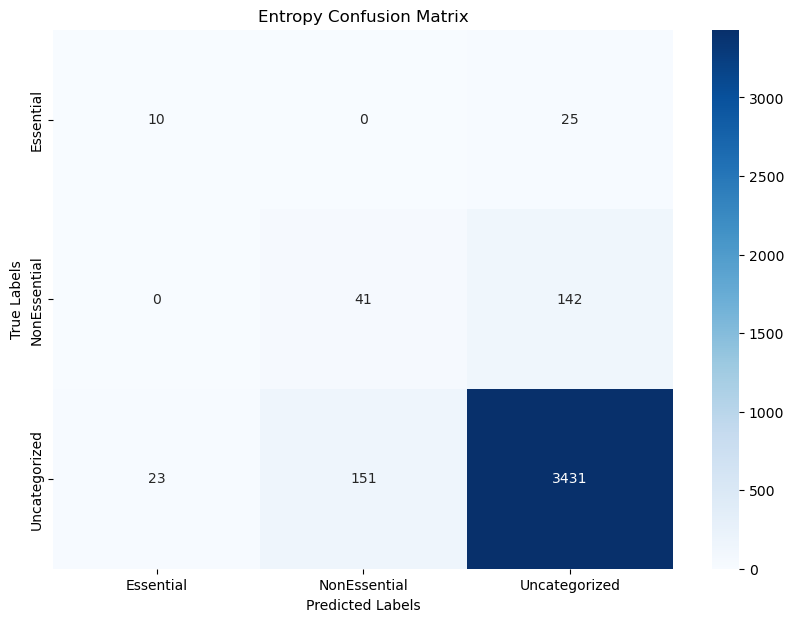

In [25]:
# Run this block for model evaluation metrics 
print("Model Entropy - no max depth")
print("Accuracy:", metrics.accuracy_score(y_test, entr_nonopt_y_pred))
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_test, entr_nonopt_y_pred))

fig = create_plot_confusion_matrix(y_test, entr_nonopt_y_pred, 'Entropy Confusion Matrix')
plt.show()

In [26]:
# Print the results from the above model
print("Tuned Decision Tree Model")
print("Accuracy:", metrics.accuracy_score(y_test, entr_nonopt_y_pred))
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_test, entr_nonopt_y_pred))
print(metrics.classification_report(y_test, entr_nonopt_y_pred))

# Define the mapping from numerical values to string labels
label_mapping = {0: 'NonEssential', 1: 'Essential', -1: 'Unkown'}

# Map the numerical values to string labels
y_test_mapped = y_test.map(label_mapping)
y_pred_mapped = pd.Series(entr_nonopt_y_pred).map(label_mapping)

# Calculate the confusion matrix
conf_matrix = metrics.confusion_matrix(y_test_mapped, y_pred_mapped)

# Get the unique class labels
class_labels = ['Essential', 'NonEssential', 'Unknown']


Tuned Decision Tree Model
Accuracy: 0.9108030342662831
Balanced accuracy: 0.4871639015837646
              precision    recall  f1-score   support

          -1       0.95      0.95      0.95      3605
           0       0.21      0.22      0.22       183
           1       0.30      0.29      0.29        35

    accuracy                           0.91      3823
   macro avg       0.49      0.49      0.49      3823
weighted avg       0.91      0.91      0.91      3823



In [27]:
ent_feature_importances=entr_nonopt_model.feature_importances_

# Create a DataFrame to display the feature importances
feature_importances_df = pd.DataFrame({
    'Feature': X_train.columns,
    'Importance': ent_feature_importances
}).sort_values(by='Importance', ascending=False)

# Display the feature importances
print(feature_importances_df)


               Feature  Importance
8      cell_exp_median    0.269161
13      Rep_CPM_median    0.110157
7        cell_exp_mean    0.065917
10               LOEUF    0.057246
4            Tx Length    0.055672
6          Gene Length    0.047100
2      start_count_std    0.044117
14         Rep_CPM_std    0.042436
17            Diff_std    0.041826
16         Diff_median    0.040407
12        Rep_CPM_mean    0.035532
11   TargetEx2TxLength    0.035425
15           Diff_mean    0.034553
5   Gene Isoform Count    0.034186
9     cell_exp_std_dev    0.029515
1   start_count_median    0.023136
0     start_count_mean    0.020623
3      Target Exon_min    0.012992


Interesting that RepA median is weighted above other counts. Expression seems to be the biggest factor. I expected LOEUF to be higher, but still in the top 4. 

Note: when the 'Uncategorized' class is retained, expression level is the most important feature, followed by the RepA_CPM_median

# Observation

Accuracy is high because most Uncategorized genes get categorized correctly, but we are not doing a very good job on predicting gene essentiality- in fact, most of these are classified as 'Uncategorized'. 

In [28]:
# gini model
gini_nonopt_model=tree.DecisionTreeClassifier(criterion='gini', random_state=1338)
#fit model
gini_nonopt_model.fit(X_train, y_train)
#predict
gini_nonopt_y_pred = gini_nonopt_model.predict(X_test)
#turn into a series
gini_nonopt_y_pred = pd.Series(gini_nonopt_y_pred)

In [29]:
# Visualize Tree
dot_data = StringIO()

tree.export_graphviz(gini_nonopt_model, out_file=dot_data,
                     filled=True, rounded=True,
                     special_characters=True, feature_names=X_train.columns, class_names=['Uncharacterized', 'NonEssential', 'Essential'])
graph=pydotplus.graph_from_dot_data(dot_data.getvalue())
Image(graph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.769269 to fit



# Observation

Also- very complicated!

Model Gini - no max depth
Accuracy: 0.9110646089458541
Balanced accuracy: 0.48112644601583004


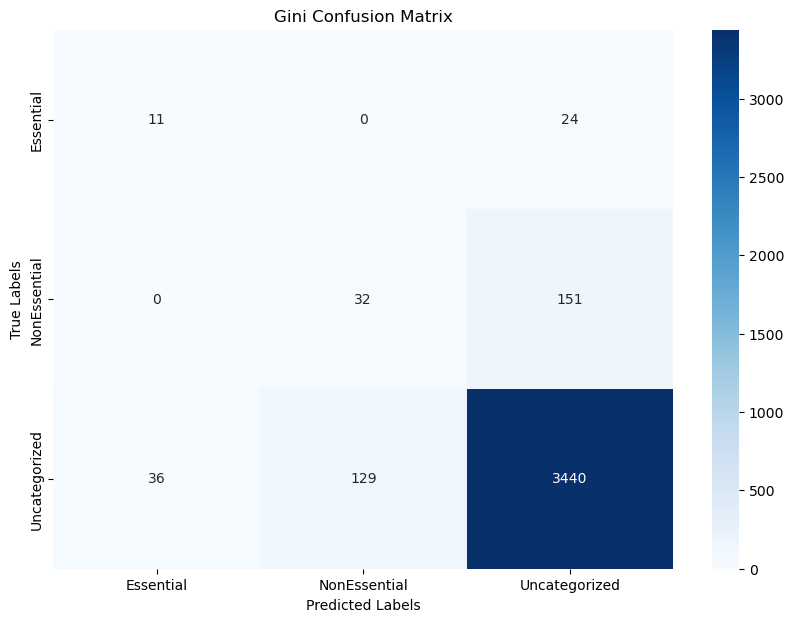

In [30]:
# Run this block for model evaluation metrics 
print("Model Gini - no max depth")
print("Accuracy:", metrics.accuracy_score(y_test, gini_nonopt_y_pred))
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_test, gini_nonopt_y_pred))

fig = create_plot_confusion_matrix(y_test, gini_nonopt_y_pred, 'Gini Confusion Matrix')
plt.show()

In [31]:
gini_feature_importances=gini_nonopt_model.feature_importances_

# Create a DataFrame to display the feature importances
feature_importances_df = pd.DataFrame({
    'Feature': X_train.columns,
    'Importance': gini_feature_importances
}).sort_values(by='Importance', ascending=False)

# Display the feature importances
print(feature_importances_df)

               Feature  Importance
7        cell_exp_mean    0.153465
10               LOEUF    0.086592
6          Gene Length    0.070404
11   TargetEx2TxLength    0.065710
13      Rep_CPM_median    0.060631
2      start_count_std    0.056595
17            Diff_std    0.055995
12        Rep_CPM_mean    0.053807
4            Tx Length    0.052354
8      cell_exp_median    0.052046
14         Rep_CPM_std    0.051303
16         Diff_median    0.048550
9     cell_exp_std_dev    0.047056
0     start_count_mean    0.042523
1   start_count_median    0.034198
15           Diff_mean    0.032485
3      Target Exon_min    0.018224
5   Gene Isoform Count    0.018062


Interesting to see the shift in feature importances. 

# Observation

Did slightly worse- called two more genes Essential. Both models performed more poorly after removing Target Gene ID! (this is odd- this is just a random identifier.)

# Conclusion

This base model performs poorly. Likely:

* too many correlated features
* too many genes in the Uncharacterized category that may be essential or nonessential.

Next step:

Focus on RandomForest and XGBoost models. 

# Random Forest

* Based on decision trees, less reduce redundant features. 
    + For the counts, just take RepA
    + one dataframe with means, one with median, then one with std
    + test all on unoptimized
* Pick beset feature sets
    + do hyperparameter tuning
    + 5-fold cross-validation

In [32]:
print(X_train.columns)

Index(['start_count_mean', 'start_count_median', 'start_count_std',
       'Target Exon_min', 'Tx Length', 'Gene Isoform Count', 'Gene Length',
       'cell_exp_mean', 'cell_exp_median', 'cell_exp_std_dev', 'LOEUF',
       'TargetEx2TxLength', 'Rep_CPM_mean', 'Rep_CPM_median', 'Rep_CPM_std',
       'Diff_mean', 'Diff_median', 'Diff_std'],
      dtype='object')


In [33]:
# now make three dataframes - mean, median and std
non_mean_cols=['start_count_median', 'start_count_std', 'Rep_CPM_median', 'Rep_CPM_std', 'Diff_median', 'Diff_std', 'cell_exp_median', 'cell_exp_std_dev']
non_med_cols=['start_count_mean', 'start_count_std', 'Rep_CPM_mean', 'Rep_CPM_std', 'Diff_mean', 'Diff_std', 'cell_exp_mean', 'cell_exp_std_dev']
non_std_cols=['start_count_mean', 'start_count_median', 'Rep_CPM_mean', 'Rep_CPM_median', 'Diff_mean', 'Diff_median','cell_exp_mean', 'cell_exp_median']
gene_inf_cols=['Target Exon_min', 'Tx Length', 'Gene Isoform Count', 'Gene Length', 'LOEUF', 'TargetEx2TxLength']
X_train_mean=X_train.drop(columns=non_mean_cols)
X_test_mean=X_test.drop(columns=non_mean_cols)
X_train_med=X_train.drop(columns=non_med_cols)
X_test_med=X_test.drop(columns=non_med_cols)
X_train_std=X_train.drop(columns=non_std_cols)
X_test_std=X_test.drop(columns=non_std_cols)
show(X_train_mean.head())
show(X_train_med.head())
show(X_train_std.head())
print(X_train_mean.shape)
print(X_test_mean.shape)
print(X_train_med.shape)
print(X_test_med.shape)
print(X_train_std.shape)
print(X_test_std.shape)
print(y_train.shape)
print(y_test.shape)

(15292, 10)
(3823, 10)
(15292, 10)
(3823, 10)
(15292, 10)
(3823, 10)
(15292,)
(3823,)


In [34]:
#Try simple models first, then try hyper parameter tuning
# Create a named tuple to map dataframes to names
DataFrameSet = namedtuple('DataFrameSet', ['mean', 'median', 'std'])

# Instantiate the named tuple with the three dataframes
train_sets = DataFrameSet(mean=X_train_mean, median=X_train_med, std=X_train_std)
test_sets = DataFrameSet(mean=X_test_mean, median=X_test_med, std=X_test_std)

Testing mean


Results for mean set:
Accuracy: 0.9432382945330892
F1 Score: 0.9253469592833812
              precision    recall  f1-score   support

          -1       0.95      0.99      0.97      3605
           0       0.43      0.08      0.14       183
           1       0.75      0.26      0.38        35

    accuracy                           0.94      3823
   macro avg       0.71      0.44      0.50      3823
weighted avg       0.92      0.94      0.93      3823



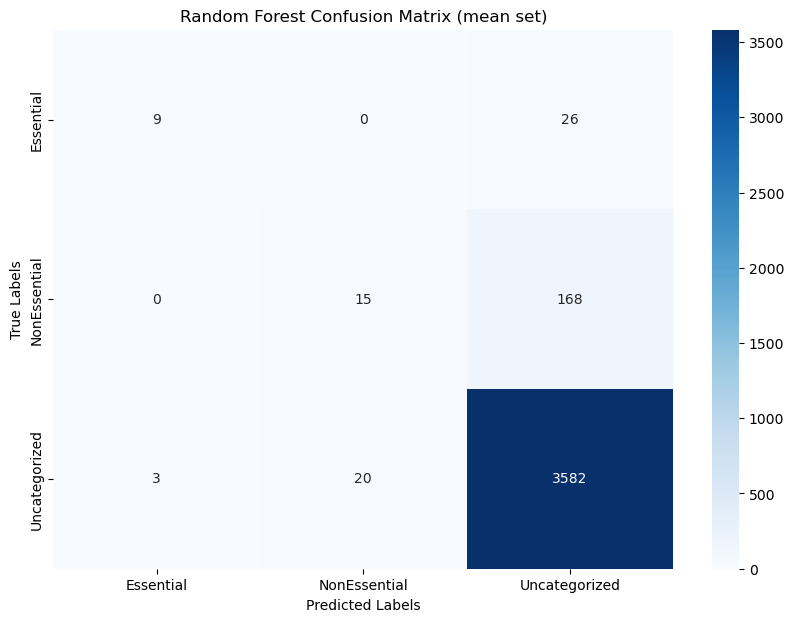

Testing median


Results for median set:
Accuracy: 0.9448077426105153
F1 Score: 0.9246597114285617
              precision    recall  f1-score   support

          -1       0.95      1.00      0.97      3605
           0       0.48      0.05      0.10       183
           1       0.83      0.29      0.43        35

    accuracy                           0.94      3823
   macro avg       0.75      0.45      0.50      3823
weighted avg       0.92      0.94      0.92      3823



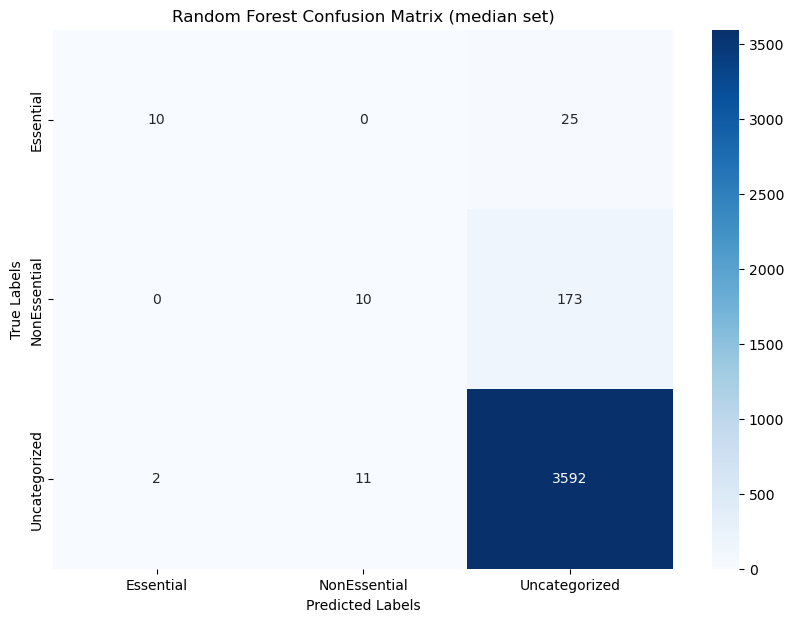

Testing std


Results for std set:
Accuracy: 0.9434998692126603
F1 Score: 0.9242621924551458
              precision    recall  f1-score   support

          -1       0.95      1.00      0.97      3605
           0       0.47      0.08      0.13       183
           1       0.75      0.17      0.28        35

    accuracy                           0.94      3823
   macro avg       0.72      0.41      0.46      3823
weighted avg       0.92      0.94      0.92      3823



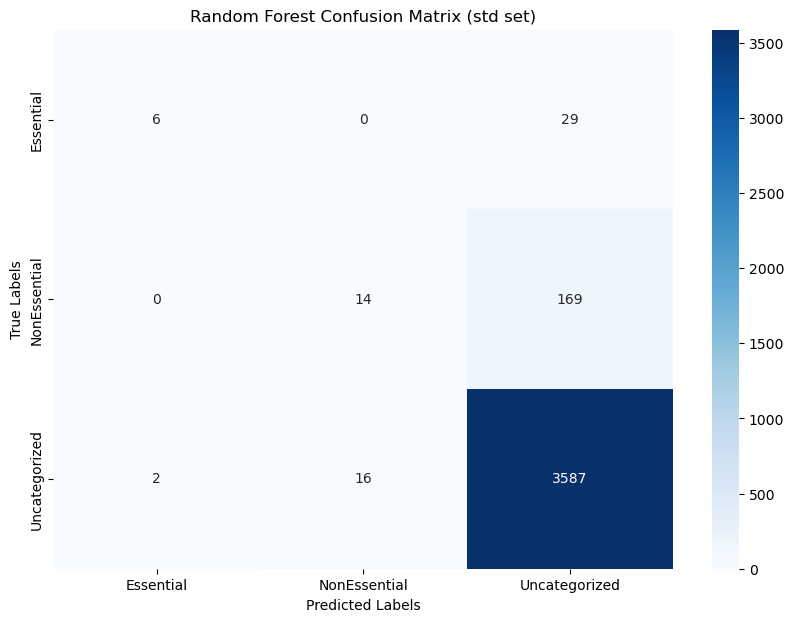

In [35]:
# Iterate through the named tuples
for set_name in train_sets._fields:
    print(f"Testing {set_name}")
    # Get the corresponding train and test sets
    X_train_set = getattr(train_sets, set_name)
    X_test_set = getattr(test_sets, set_name)
    
    # Initialize the RandomForestClassifier
    rf_model = RandomForestClassifier(n_estimators=300, random_state=1338)
    
    # Fit the model
    rf_model.fit(X_train_set, y_train)
    
    # Predict the test set
    y_pred = rf_model.predict(X_test_set)
    
    #print features importances
    feat=rf_model.feature_importances_

    # Create a DataFrame to display the feature importances
    feature_importances_df = pd.DataFrame({
        'Feature': X_train_set.columns,
        'Importance': feat
    }).sort_values(by='Importance', ascending=False)

    # Display the feature importances
    show(feature_importances_df)   
    # Calculate accuracy and F1 score
    accuracy = metrics.accuracy_score(y_test, y_pred)
    f1_score = metrics.f1_score(y_test, y_pred, average='weighted')
    
    # Print the results
    print(f"Results for {set_name} set:")
    print(f"Accuracy: {accuracy}")
    print(f"F1 Score: {f1_score}")
    print(metrics.classification_report(y_test, y_pred))
    
    # Create and display the confusion matrix
    fig = create_plot_confusion_matrix(y_test, y_pred, f'Random Forest Confusion Matrix ({set_name} set)')
    plt.show()

# Observation

All three still perform pretty poorly. But, the mean is slightyly better. The relative feature importances are the same though, with expression having the biggest impact. Will try hyperparameter tuning on X_train_mean.

Interestingly- essential and nonessential genes aren't getting confused- it is the Uncategorized genes that are causing the confusion. There are likely essential and non-essential genes (at least for this cell line) in that mix.


In [36]:
# parameter testing
#param_grid = {'n_estimators': np.arange(10,200,10), 'criterion': ['gini', 'entropy', 'log_loss'], 'max_depth': np.arange(3,20)}
#rf=RandomForestClassifier(random_state=1338)
#rf_cv=GridSearchCV(rf, param_grid, cv=5)
#rf_cv.fit(X_train_mean, y_train)
#print("Best Score:" + str(rf_cv.best_estimator_))
#print("Best Score:" + str(rf_cv.best_score_))
#print("Best params: " + str(rf_cv.best_params_))


# Notes on GridSearch

This took 483m 38.4s to run

Best Score:RandomForestClassifier(criterion='entropy', max_depth=11, n_estimators=190,
                       random_state=1338)

Best Score:0.9470311046476201

Best params: {'criterion': 'entropy', 'max_depth': 11, 'n_estimators': 190}

Noting this so I can comment out code to not have to rerun if I rerun the notebook.

Results for std set:
Accuracy: 0.9437614438922313
F1 Score: 0.9228660634659972
              precision    recall  f1-score   support

          -1       0.95      1.00      0.97      3605
           0       0.42      0.04      0.08       183
           1       0.75      0.26      0.38        35

    accuracy                           0.94      3823
   macro avg       0.71      0.43      0.48      3823
weighted avg       0.92      0.94      0.92      3823



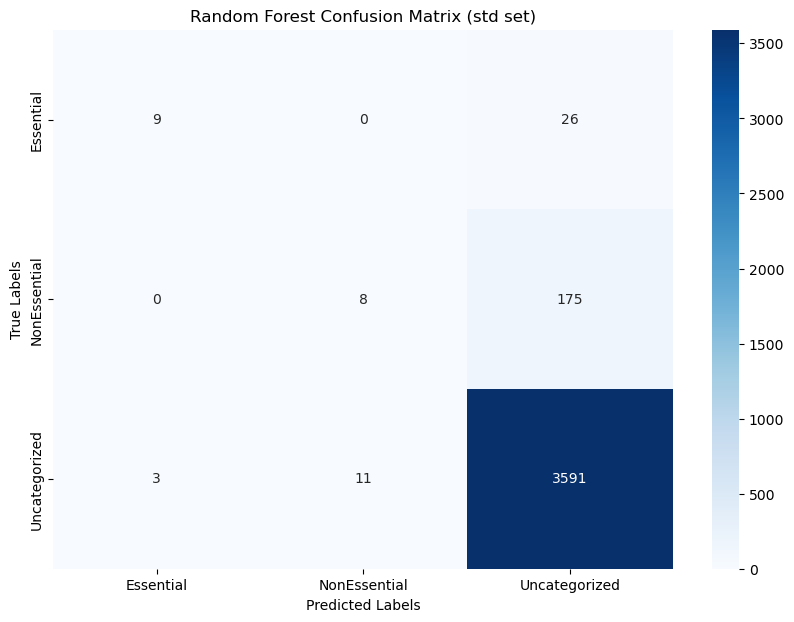

In [37]:
# Train and test model using GridSearch parameters

# Initialize the RandomForestClassifier
rf_model = RandomForestClassifier(n_estimators=190, criterion='entropy', max_depth=11, random_state=1338)
    
# Fit the model
rf_model.fit(X_train_mean, y_train)
    
# Predict the test set
y_pred = rf_model.predict(X_test_mean)
    
#print features importances
feat=rf_model.feature_importances_

# Create a DataFrame to display the feature importances
feature_importances_df = pd.DataFrame({
    'Feature': X_train_set.columns,
    'Importance': feat
}).sort_values(by='Importance', ascending=False)

# Display the feature importances
show(feature_importances_df)   
# Calculate accuracy and F1 score
accuracy = metrics.accuracy_score(y_test, y_pred)
f1_score = metrics.f1_score(y_test, y_pred, average='weighted')
    
# Print the results
print(f"Results for {set_name} set:")
print(f"Accuracy: {accuracy}")
print(f"F1 Score: {f1_score}")
print(metrics.classification_report(y_test, y_pred))
    
# Create and display the confusion matrix
fig = create_plot_confusion_matrix(y_test, y_pred, f'Random Forest Confusion Matrix ({set_name} set)')
plt.show()

# Observations

This is still a crappy model. Most things (essential and non-essential are getting categorized as 'Uncategorized'). This further supports my notion that there are likely essential and non-essential genes in the 'Uncategorized' set. 

# XGBoost

Will try full dataset on XGBoost model. 

Using: https://www.kaggle.com/code/emmanuelfwerr/xgboost-multi-class-classification as a guide


              precision    recall  f1-score   support

          -1       0.95      1.00      0.97      3605
           0       0.42      0.04      0.08       183
           1       0.75      0.26      0.38        35

    accuracy                           0.94      3823
   macro avg       0.71      0.43      0.48      3823
weighted avg       0.92      0.94      0.92      3823

Confusion Matrix:


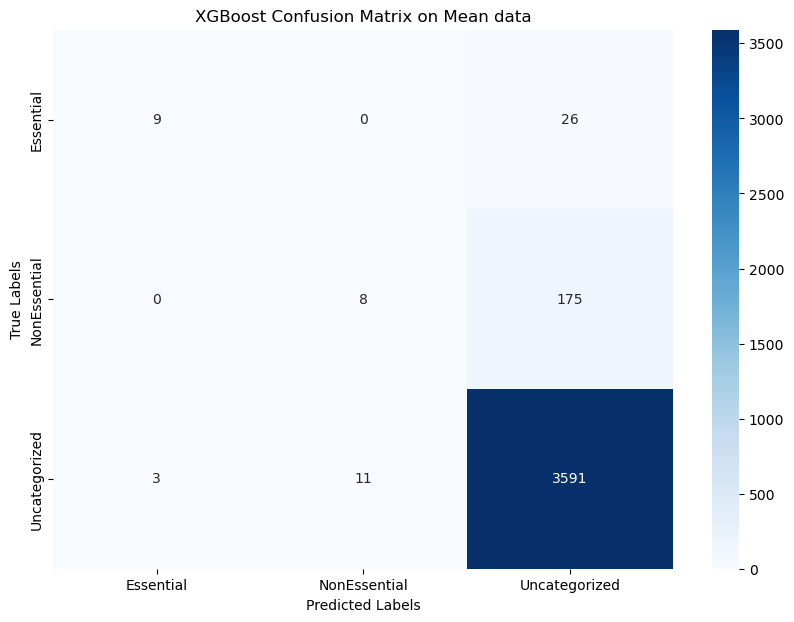

In [38]:
# Run with default hyper parameters

# XGBoost is expecting consecutive integers for the labels, so I need to map -1, 0, 1 to 0,1,2
label_mapping={-1: 2, 0: 0, 1:1}
y_train_mapped = y_train.map(label_mapping)
y_test_mapped = y_test.map(label_mapping)

xgb_clf = xgb.XGBClassifier(objective='multi:softmax',
                            num_class=3,
                            missing=1,
                            early_stopping_rounds=10,
                            eval_metric=['merror', 'mlogloss'], 
                            seed=42)
xgb_clf.fit(X_train_mean, y_train_mapped, verbose=0, eval_set=[(X_train_mean, y_train_mapped), (X_test_mean, y_test_mapped)])


## ---------- Model Classification Report ----------
## get predictions and create model quality report

y_pred_mapped = xgb_clf.predict(X_test_mean)

# Evaluate the model
print(classification_report(y_test, y_pred))

# Calculate the confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)

# Print the confusion matrix
print("Confusion Matrix:")
# Create and display the confusion matrix
fig = create_plot_confusion_matrix(y_test, y_pred, f'XGBoost Confusion Matrix on Mean data')
plt.show()

# Observation

This looks as bad as the Random Forest!

# Conclusion

The uncategorized data is causing too much confusion in the model building. What happens if we try to remove this data and just train on the 'essential' and 'Nonessential' labels?

# Binary classification

1. Remove Uncategorized genes
2. Go ahead and get rid of correlated, redundant columns
2. Repeat process from above

In [39]:
print(full_df.shape)
# Drop rows where 'Annotation' is 'Uncategorized'
mini_df = full_df[full_df['Annotation'] != -1]

print(mini_df.shape)
# Display the updated dataframe
mini_df=mini_df.reset_index()
show(mini_df)

(19115, 19)
(1065, 19)


In [40]:
mini_df=mini_df.set_index('Target Gene ID')
show(mini_df.head())

In [41]:
X_mini = mini_df.drop(columns=['Annotation'])
y_mini = mini_df['Annotation']
show(X_mini.head())
show(y_mini.head())

In [42]:
# test, train splits
X_mini_train, X_mini_test, y_mini_train, y_mini_test = train_test_split(X_mini, y_mini, test_size=0.2, random_state=42)

print(f"X train: {X_mini_train.shape}")
print(f"X test: {X_mini_test.shape}")

print(f"Annotation mini: {mini_df['Annotation'].value_counts()} {mini_df['Annotation'].value_counts(normalize=True) * 100}%")
print(f"Annotation split (train): {y_mini_train.value_counts()} {y_mini_train.value_counts(normalize=True) * 100}%")
print(f"Annotation split (test) {y_mini_test.value_counts()} {y_mini_test.value_counts(normalize=True) * 100}%")

X train: (852, 18)
X test: (213, 18)
Annotation mini: Annotation
0    858
1    207
Name: count, dtype: int64 Annotation
0    80.56338
1    19.43662
Name: proportion, dtype: float64%
Annotation split (train): Annotation
0    686
1    166
Name: count, dtype: int64 Annotation
0    80.516432
1    19.483568
Name: proportion, dtype: float64%
Annotation split (test) Annotation
0    172
1     41
Name: count, dtype: int64 Annotation
0    80.751174
1    19.248826
Name: proportion, dtype: float64%


In [43]:
X_mini_train_mean=X_mini_train.drop(columns=non_mean_cols)
X_mini_test_mean=X_mini_test.drop(columns=non_mean_cols)
X_mini_train_med=X_mini_train.drop(columns=non_med_cols)
X_mini_test_med=X_mini_test.drop(columns=non_med_cols)
X_mini_train_std=X_mini_train.drop(columns=non_std_cols)
X_mini_test_std=X_mini_test.drop(columns=non_std_cols)
show(X_mini_train_mean.head())
show(X_mini_train_med.head())
show(X_mini_train_std.head())
print(X_mini_train_mean.shape)
print(X_mini_test_mean.shape)
print(X_mini_train_med.shape)
print(X_mini_test_med.shape)
print(X_mini_train_std.shape)
print(X_mini_test_std.shape)
print(y_mini_train.shape)
print(y_mini_test.shape)

(852, 10)
(213, 10)
(852, 10)
(213, 10)
(852, 10)
(213, 10)
(852,)
(213,)


In [44]:
# will make named tuples in case I want to cycle again, but may do some quick tests with mean

# Instantiate the named tuple with the three dataframes
mini_train_sets = DataFrameSet(mean=X_mini_train_mean, median=X_mini_train_med, std=X_mini_train_std)
mini_test_sets = DataFrameSet(mean=X_mini_test_mean, median=X_mini_test_med, std=X_mini_test_std)

# Decision Tree

## Mean, mini set

In [45]:
print(X_mini_train_mean.shape)
print(y_mini_train.shape)

(852, 10)
(852,)


In [46]:
# entropy model
mini_entr_nonopt_model=tree.DecisionTreeClassifier(criterion='entropy', random_state=1338)
#fit model
mini_entr_nonopt_model.fit(X_mini_train_mean, y_mini_train)
#predict
mini_entr_nonopt_y_pred = mini_entr_nonopt_model.predict(X_mini_test_mean)
#turn into a series
mini_entr_nonopt_y_pred = pd.Series(mini_entr_nonopt_y_pred)

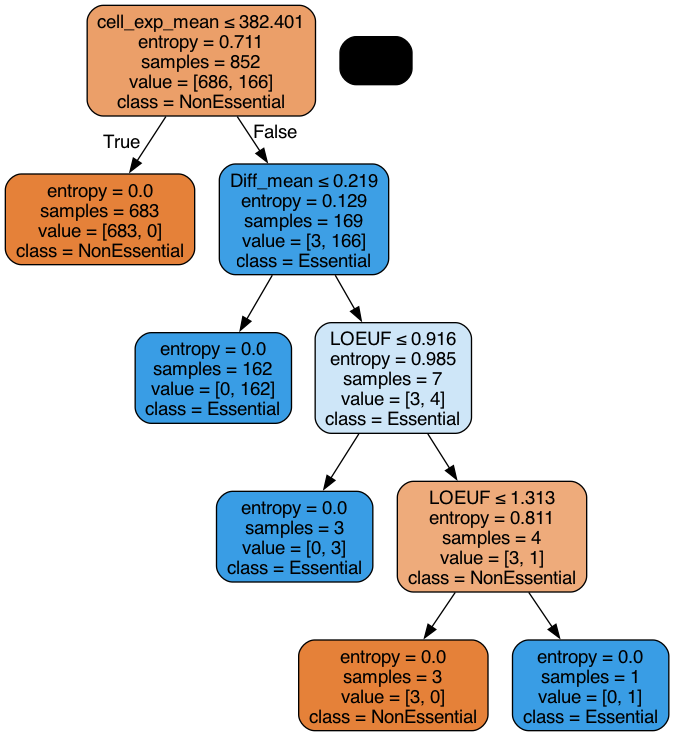

In [47]:
# Visualize Tree
dot_data = StringIO()

tree.export_graphviz(mini_entr_nonopt_model, out_file=dot_data,
                     filled=True, rounded=True,
                     special_characters=True, feature_names=X_mini_train_mean.columns, class_names=['NonEssential', 'Essential'])
graph=pydotplus.graph_from_dot_data(dot_data.getvalue())
Image(graph.create_png())

Model Entropy - no max depth
Accuracy: 0.9953051643192489
Balanced accuracy: 0.997093023255814
              precision    recall  f1-score   support

           0       1.00      0.99      1.00       172
           1       0.98      1.00      0.99        41

    accuracy                           1.00       213
   macro avg       0.99      1.00      0.99       213
weighted avg       1.00      1.00      1.00       213



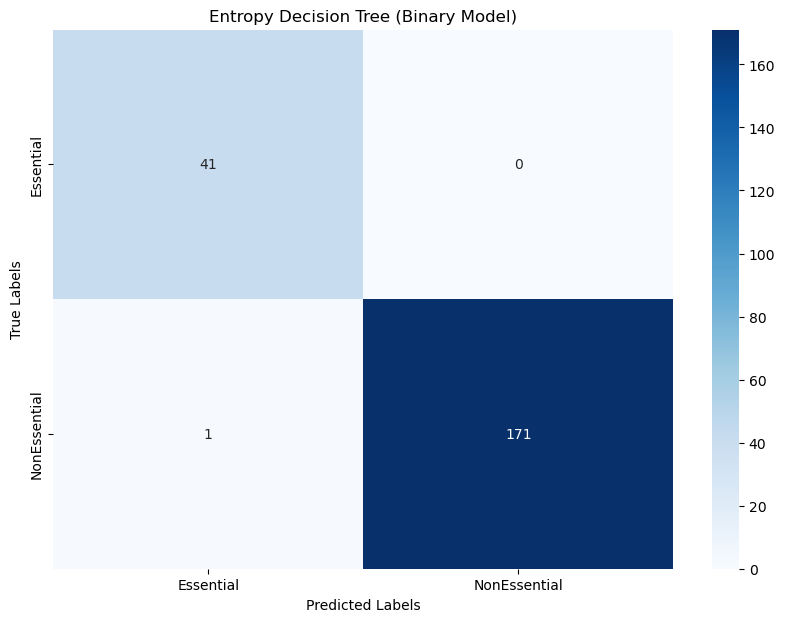

In [48]:
# Run this block for model evaluation metrics 
print("Model Entropy - no max depth")
print("Accuracy:", metrics.accuracy_score(y_mini_test, mini_entr_nonopt_y_pred))
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_mini_test, mini_entr_nonopt_y_pred))
print(metrics.classification_report(y_mini_test, mini_entr_nonopt_y_pred))

 # Define the mapping from numerical values to string labels
label_mapping = {0: 'NonEssential', 1: 'Essential'}

# Map the numerical values to string labels
mini_y_test_mapped = y_mini_test.map(label_mapping)
mini_y_pred_mapped = pd.Series(mini_entr_nonopt_y_pred).map(label_mapping)

# Calculate the confusion matrix
conf_matrix = metrics.confusion_matrix(mini_y_test_mapped, mini_y_pred_mapped)

# Get the unique class labels
class_labels = ['Essential', 'NonEssential']

# Plot the confusion matrix
#fig = plt.figure(figsize=(10, 7))
#sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
#plt.xlabel('Predicted Labels')
#plt.ylabel('True Labels')
#plt.title("Entropy Confusion Matrix: Binary Model (mean)")
fig = create_plot_confusion_matrix(y_mini_test, mini_entr_nonopt_y_pred, f'Entropy Decision Tree (Binary Model)', binary='yes')
plt.show()

#print features importances
feat=mini_entr_nonopt_model.feature_importances_
# Create a DataFrame to display the feature importances
feature_importances_df = pd.DataFrame({
    'Feature': X_mini_test_mean.columns,
    'Importance': feat
}).sort_values(by='Importance', ascending=False)

# Display the feature importances
show(feature_importances_df)   

In [49]:
X_mini_test_results=X_mini_test_mean.copy()
X_mini_test_results['annots']=mini_y_test_mapped
X_mini_test_results['pred']=mini_y_pred_mapped.values
X_mini_test_results['correct'] = (X_mini_test_results['annots']==X_mini_test_results['pred'])
show(X_mini_test_results)

In [50]:
bin_entr_model_wrong_df = X_mini_test_results[X_mini_test_results['correct'] == False]
show(bin_entr_model_wrong_df)

# Conclusion

OK- the simple, non-optimized decision tree does a pretty good job once you remove the 'Uncategorized' data. This supports my concern that the 'Uncategorized' data has both 'essential' and 'nonessential' genes, and this is confusing the classification model. 

# Next step
Optimize a bit more and try on a couple of additional datasets. 

In [51]:
# gini model
gini_nonopt_model=tree.DecisionTreeClassifier(criterion='gini', random_state=1338)
#fit model
gini_nonopt_model.fit(X_mini_train_mean, y_mini_train)
#predict
gini_nonopt_y_pred = gini_nonopt_model.predict(X_mini_test_mean)
#turn into a series
gini_nonopt_y_pred = pd.Series(gini_nonopt_y_pred)

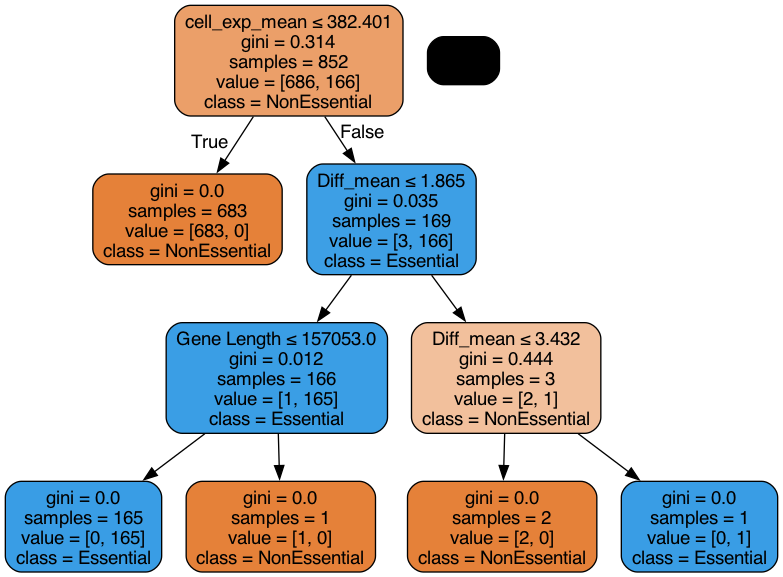

In [52]:
# Visualize Tree
dot_data = StringIO()

tree.export_graphviz(gini_nonopt_model, out_file=dot_data,
                     filled=True, rounded=True,
                     special_characters=True, feature_names=X_mini_train_mean.columns, class_names=['NonEssential', 'Essential'])
graph=pydotplus.graph_from_dot_data(dot_data.getvalue())
Image(graph.create_png())

Model Gini - no max depth
Accuracy: 0.9906103286384976
Balanced accuracy: 0.9941860465116279
              precision    recall  f1-score   support

           0       1.00      0.99      0.99       172
           1       0.95      1.00      0.98        41

    accuracy                           0.99       213
   macro avg       0.98      0.99      0.99       213
weighted avg       0.99      0.99      0.99       213



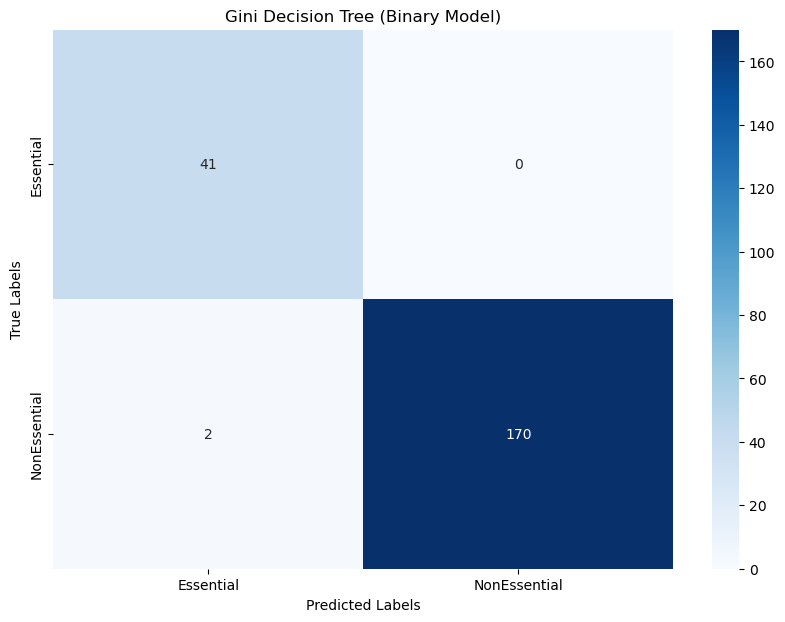

In [53]:
# Run this block for model evaluation metrics 
print("Model Gini - no max depth")
print("Accuracy:", metrics.accuracy_score(y_mini_test, gini_nonopt_y_pred))
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_mini_test, gini_nonopt_y_pred))
print(metrics.classification_report(y_mini_test, gini_nonopt_y_pred))

 # Define the mapping from numerical values to string labels
label_mapping = {0: 'NonEssential', 1: 'Essential'}

# Map the numerical values to string labels
y_test_mapped = y_mini_test.map(label_mapping)
y_pred_mapped = pd.Series(gini_nonopt_y_pred).map(label_mapping)

# Calculate the confusion matrix
conf_matrix = metrics.confusion_matrix(y_test_mapped, y_pred_mapped)

# Get the unique class labels
class_labels = ['Essential', 'NonEssential']

# Plot the confusion matrix
#fig = plt.figure(figsize=(10, 7))
#sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
#plt.xlabel('Predicted Labels')
#plt.ylabel('True Labels')
#plt.title("Gini Confusion Matrix: Binary Model (mean)")
fig = create_plot_confusion_matrix(y_mini_test, gini_nonopt_y_pred, f'Gini Decision Tree (Binary Model)', binary='yes')
plt.show()

#print features importances
feat=gini_nonopt_model.feature_importances_
# Create a DataFrame to display the feature importances
feature_importances_df = pd.DataFrame({
    'Feature': X_mini_test_mean.columns,
    'Importance': feat
}).sort_values(by='Importance', ascending=False)

# Display the feature importances
show(feature_importances_df) 

In [54]:
X_mini_test_results=X_mini_test_mean.copy()
X_mini_test_results['annots']=y_test_mapped
X_mini_test_results['pred']=y_pred_mapped.values
X_mini_test_results['correct'] = (X_mini_test_results['annots']==X_mini_test_results['pred'])
show(X_mini_test_results)

In [55]:
bin_gini_model_wrong_df = X_mini_test_results[X_mini_test_results['correct'] == False]
show(bin_gini_model_wrong_df)

# Conclusion

Both models predicted all Essential genes correctly- entropy model misclassified one non-essential gene as essential. The gini model was slightly worse and mispredicted 2 genes. 

In [56]:
# parameter testing for Decision tree
param_grid = {'max_depth': [2, 4, 6, None], 'criterion': ['gini', 'entropy', 'log_loss'], 'min_samples_split': [5,10,15], 'max_features': [2,3,4,5,6]}
dtree=tree.DecisionTreeClassifier(random_state=1338)
dtree_cv=GridSearchCV(dtree, param_grid, cv=5)
dtree_cv.fit(X_mini_train_mean, y_mini_train)
print("Best Score:" + str(dtree_cv.best_estimator_))
print("Best Score:" + str(dtree_cv.best_score_))
print("Best params: " + str(dtree_cv.best_params_))

Best Score:DecisionTreeClassifier(max_depth=4, max_features=6, min_samples_split=10,
                       random_state=1338)
Best Score:0.9964774681802545
Best params: {'criterion': 'gini', 'max_depth': 4, 'max_features': 6, 'min_samples_split': 10}


In [57]:
# Optimized Decision Tree
dtree_model=tree.DecisionTreeClassifier(criterion='entropy', max_depth=4, max_features=6, min_samples_split=10, random_state=1338)
#fit model
dtree_model.fit(X_mini_train_mean, y_mini_train)
#predict
dtree_y_pred = dtree_model.predict(X_mini_test_mean)
#turn into a series
dtree_y_pred = pd.Series(dtree_y_pred)

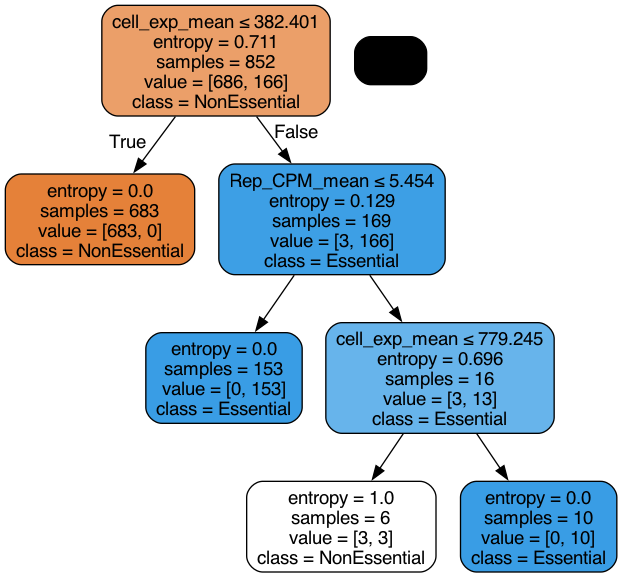

In [58]:
# Visualize Tree
dot_data = StringIO()

tree.export_graphviz(dtree_model, out_file=dot_data,
                     filled=True, rounded=True,
                     special_characters=True, feature_names=X_mini_train_mean.columns, class_names=['NonEssential', 'Essential'])
graph=pydotplus.graph_from_dot_data(dot_data.getvalue())
Image(graph.create_png())

Tuned Decision Tree Model
Accuracy: 0.9906103286384976
Balanced accuracy: 0.9848979013045944
              precision    recall  f1-score   support

           0       0.99      0.99      0.99       172
           1       0.98      0.98      0.98        41

    accuracy                           0.99       213
   macro avg       0.98      0.98      0.98       213
weighted avg       0.99      0.99      0.99       213



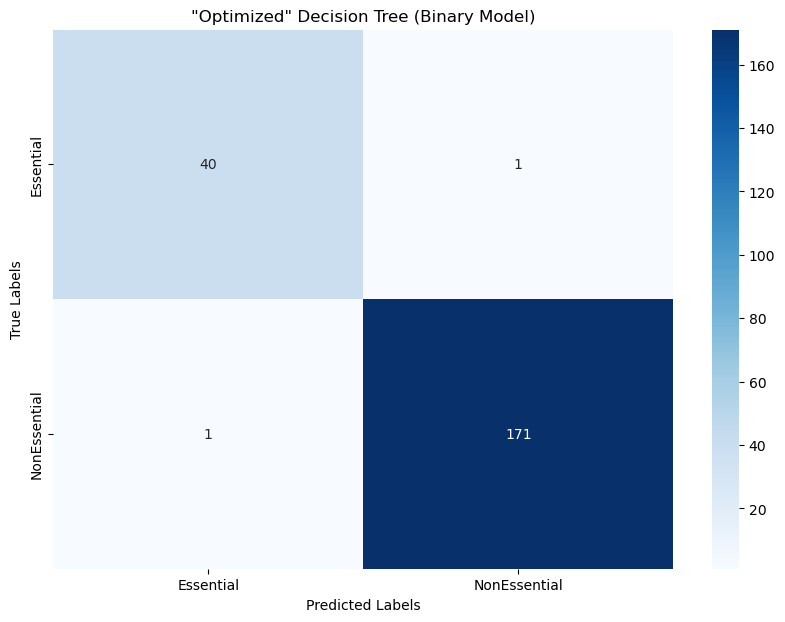

In [59]:
# Run this block for model evaluation metrics 
print("Tuned Decision Tree Model")
print("Accuracy:", metrics.accuracy_score(y_mini_test, dtree_y_pred))
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_mini_test, dtree_y_pred))
print(metrics.classification_report(y_mini_test, dtree_y_pred))

 # Define the mapping from numerical values to string labels
label_mapping = {0: 'NonEssential', 1: 'Essential'}

# Map the numerical values to string labels
y_test_mapped = y_mini_test.map(label_mapping)
y_pred_mapped = pd.Series(dtree_y_pred).map(label_mapping)

# Calculate the confusion matrix
conf_matrix = metrics.confusion_matrix(y_test_mapped, y_pred_mapped)

# Get the unique class labels
class_labels = ['Essential', 'NonEssential']

# Plot the confusion matrix
#fig = plt.figure(figsize=(10, 7))
#sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
#plt.xlabel('Predicted Labels')
#plt.ylabel('True Labels')
#plt.title("Optimized Decision Tree)")
fig = create_plot_confusion_matrix(y_mini_test, dtree_y_pred, f'"Optimized" Decision Tree (Binary Model)', binary='yes')

plt.show()



# "Optimized" model performs roughly the same as the unoptimized

2 genes are misclassified using the optimized model. 1 Essential genes and 1 Non-Essential genes.

In [60]:
final_feature_importances=dtree_model.feature_importances_

# Create a DataFrame to display the feature importances
feature_importances_df = pd.DataFrame({
    'Feature': X_mini_train_mean.columns,
    'Importance': final_feature_importances
}).sort_values(by='Importance', ascending=False)

# Display the feature importances
print(feature_importances_df)

              Feature  Importance
5       cell_exp_mean    0.982342
8        Rep_CPM_mean    0.017658
0    start_count_mean    0.000000
1     Target Exon_min    0.000000
2           Tx Length    0.000000
3  Gene Isoform Count    0.000000
4         Gene Length    0.000000
6               LOEUF    0.000000
7   TargetEx2TxLength    0.000000
9           Diff_mean    0.000000


# Observation

All models are over reliant on cell expression. This parameter accounts for the majority of the signal in the model. 
Interestingly, the next most important features is just the CPM mean value- not the count difference. No other parameters contribute. 

What happens when we remove cell_expression from the parameter list?

In [61]:
X_mini_test_results=X_mini_test_mean.copy()
X_mini_test_results['annots']=y_test_mapped
X_mini_test_results['pred']=y_pred_mapped.values
X_mini_test_results['correct'] = (X_mini_test_results['annots']==X_mini_test_results['pred'])
show(X_mini_test_results)

In [62]:
bin_opt_model_wrong_df = X_mini_test_results[X_mini_test_results['correct'] == False]
show(bin_opt_model_wrong_df)

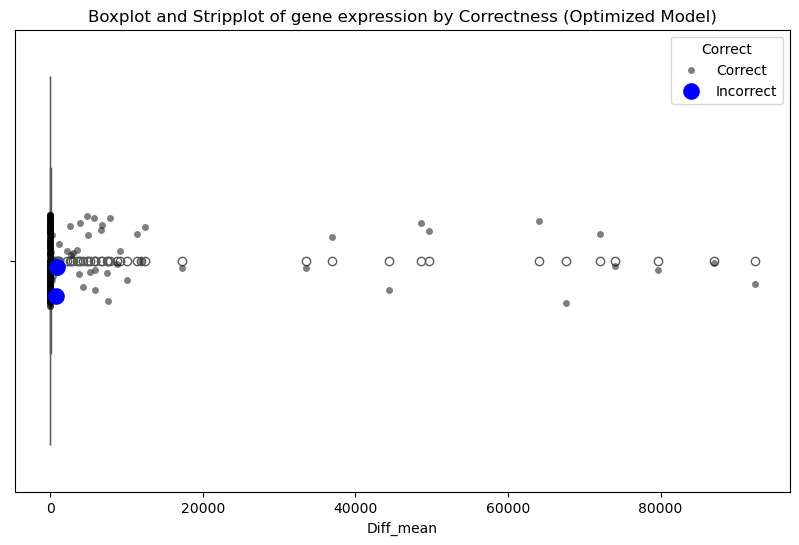

In [63]:
# Set up the figure
plt.figure(figsize=(10, 6))

# Create the boxplot
sns.boxplot(x='cell_exp_mean', data=X_mini_test_results, color="#9B9B93", boxprops=dict(alpha=0.5))

# Create the stripplot for correct=True
sns.stripplot(x='cell_exp_mean', data=X_mini_test_results[X_mini_test_results['correct'] == True], color='black', alpha=0.5, jitter=True, label='Correct')

# Create the stripplot for correct=False with larger dots
sns.stripplot(x='cell_exp_mean', data=X_mini_test_results[X_mini_test_results['correct'] == False], color='blue', alpha=1, jitter=True, size=12, label='Incorrect')

# Set the title and labels
plt.title('Boxplot and Stripplot of gene expression by Correctness (Optimized Model)')
plt.xlabel('Diff_mean')
plt.ylabel('')

# Show the legend
plt.legend(title='Correct', loc='upper right')

# Show the plot
plt.show()

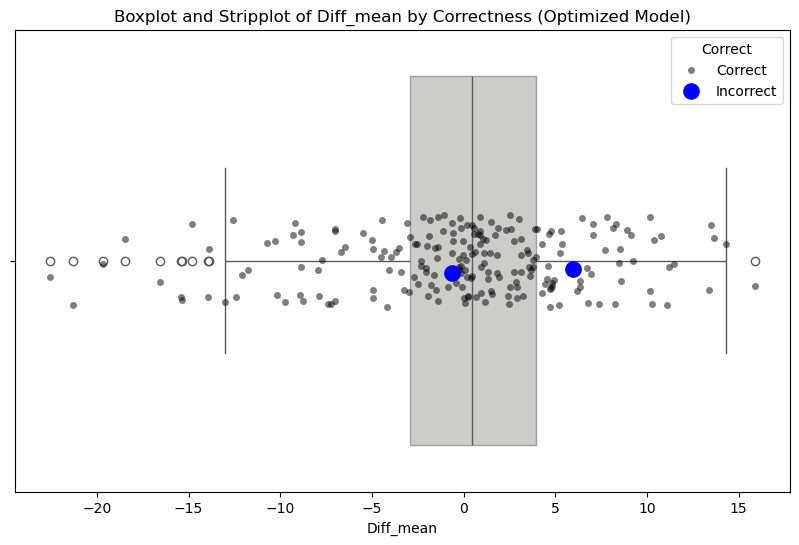

In [64]:
# Set up the figure
plt.figure(figsize=(10, 6))

# Create the boxplot
sns.boxplot(x='Diff_mean', data=X_mini_test_results, color="#9B9B93", boxprops=dict(alpha=0.5))

# Create the stripplot for correct=True
sns.stripplot(x='Diff_mean', data=X_mini_test_results[X_mini_test_results['correct'] == True], color='black', alpha=0.5, jitter=True, label='Correct')

# Create the stripplot for correct=False with larger dots
sns.stripplot(x='Diff_mean', data=X_mini_test_results[X_mini_test_results['correct'] == False], color='blue', alpha=1, jitter=True, size=12, label='Incorrect')

# Set the title and labels
plt.title('Boxplot and Stripplot of Diff_mean by Correctness (Optimized Model)')
plt.xlabel('Diff_mean')
plt.ylabel('')

# Show the legend
plt.legend(title='Correct', loc='upper right')

# Show the plot
plt.show()

# Model without cell expression

Remove cell_exp_mean from X_mini_train_mean and see what happens to the model!


In [117]:
X_mini_train_mean_no_exp = X_mini_train_mean.drop(columns=['cell_exp_mean'])
show(X_mini_train_mean_no_exp.head())
X_mini_test_mean_no_exp = X_mini_test_mean.drop(columns=['cell_exp_mean'])

In [118]:
# entropy model
mini_entr_nonopt_no_exp_model=tree.DecisionTreeClassifier(criterion='entropy', random_state=1338)
#fit model
mini_entr_nonopt_no_exp_model.fit(X_mini_train_mean_no_exp, y_mini_train)
#predict
mini_entr_nonopt_no_exp_y_pred = mini_entr_nonopt_no_exp_model.predict(X_mini_test_mean_no_exp)
#turn into a series
mini_entr_nonopt_no_exp_y_pred = pd.Series(mini_entr_nonopt_no_exp_y_pred)

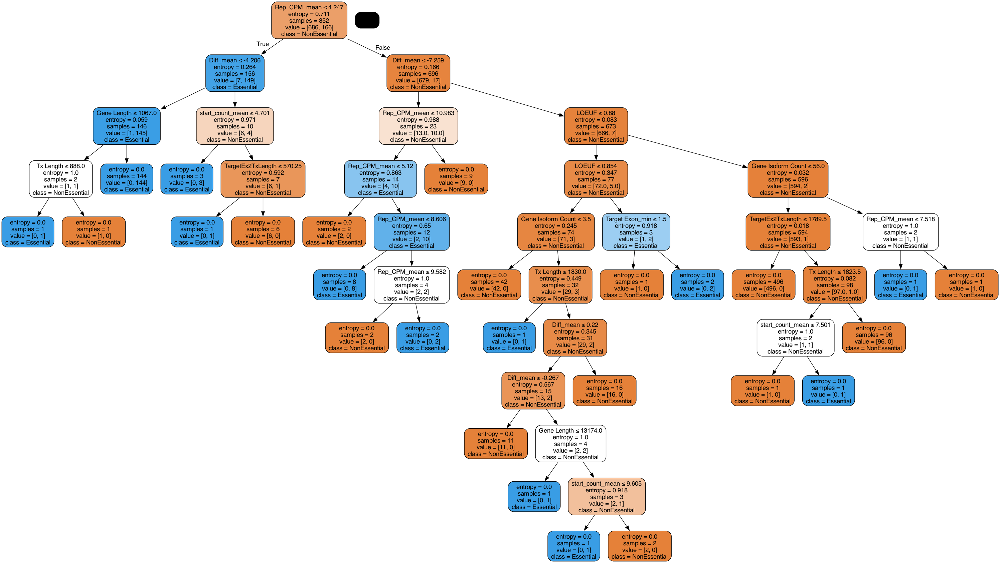

In [119]:
# Visualize Tree
dot_data = StringIO()

tree.export_graphviz(mini_entr_nonopt_no_exp_model, out_file=dot_data,
                     filled=True, rounded=True,
                     special_characters=True, feature_names=X_mini_train_mean_no_exp.columns, class_names=['NonEssential', 'Essential'])
graph=pydotplus.graph_from_dot_data(dot_data.getvalue())
Image(graph.create_png())

Model Entropy - no max depth - no expression
Accuracy: 0.9342723004694836
Balanced accuracy: 0.9221497447532615
              precision    recall  f1-score   support

           0       0.98      0.94      0.96       172
           1       0.79      0.90      0.84        41

    accuracy                           0.93       213
   macro avg       0.88      0.92      0.90       213
weighted avg       0.94      0.93      0.94       213



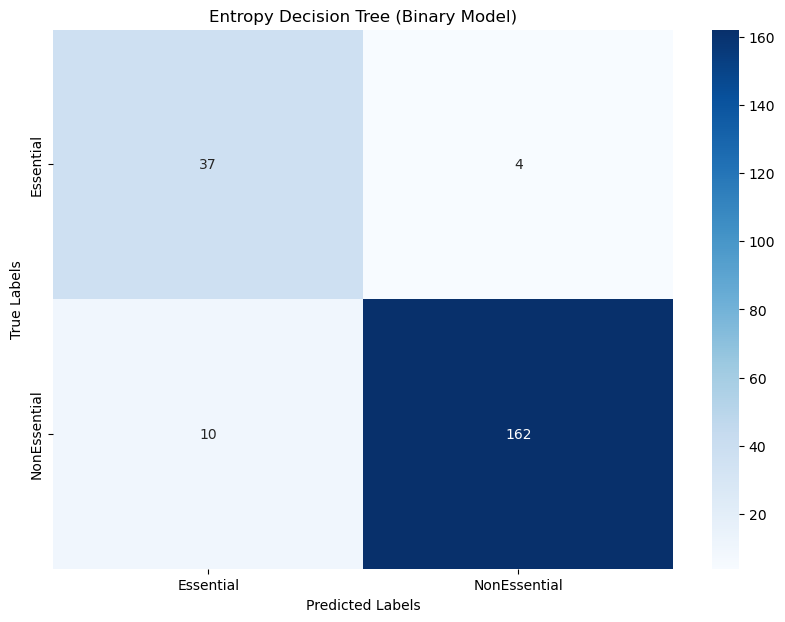

In [121]:
# Run this block for model evaluation metrics 
print("Model Entropy - no max depth - no expression")
print("Accuracy:", metrics.accuracy_score(y_mini_test, mini_entr_nonopt_no_exp_y_pred))
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_mini_test, mini_entr_nonopt_no_exp_y_pred))
print(metrics.classification_report(y_mini_test, mini_entr_nonopt_no_exp_y_pred))

 # Define the mapping from numerical values to string labels
label_mapping = {0: 'NonEssential', 1: 'Essential'}

# Map the numerical values to string labels
mini_y_test_mapped = y_mini_test.map(label_mapping)
mini_y_pred_mapped = pd.Series(mini_entr_nonopt_no_exp_y_pred).map(label_mapping)

# Calculate the confusion matrix
conf_matrix = metrics.confusion_matrix(mini_y_test_mapped, mini_y_pred_mapped)

# Get the unique class labels
class_labels = ['Essential', 'NonEssential']

# Plot the confusion matrix
#fig = plt.figure(figsize=(10, 7))
#sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
#plt.xlabel('Predicted Labels')
#plt.ylabel('True Labels')
#plt.title("Entropy Confusion Matrix: Binary Model (mean)")
fig = create_plot_confusion_matrix(y_mini_test, mini_entr_nonopt_no_exp_y_pred, f'Entropy Decision Tree (Binary Model)', binary='yes')
plt.show()

#print features importances
feat=mini_entr_nonopt_no_exp_model.feature_importances_
# Create a DataFrame to display the feature importances
feature_importances_df = pd.DataFrame({
    'Feature': X_mini_test_mean_no_exp.columns,
    'Importance': feat
}).sort_values(by='Importance', ascending=False)

# Display the feature importances
show(feature_importances_df)   

In [122]:
# parameter testing for Decision tree
param_grid = {'max_depth': [2, 4, 6, None], 'criterion': ['gini', 'entropy', 'log_loss'], 'min_samples_split': [5,10,15], 'max_features': [2,3,4,5,6]}
dtree=tree.DecisionTreeClassifier(random_state=1338)
dtree_cv=GridSearchCV(dtree, param_grid, cv=5)
dtree_cv.fit(X_mini_train_mean_no_exp, y_mini_train)
print("Best Score:" + str(dtree_cv.best_estimator_))
print("Best Score:" + str(dtree_cv.best_score_))
print("Best params: " + str(dtree_cv.best_params_))

Best Score:DecisionTreeClassifier(criterion='entropy', max_depth=4, max_features=5,
                       min_samples_split=5, random_state=1338)
Best Score:0.9765531475748194
Best params: {'criterion': 'entropy', 'max_depth': 4, 'max_features': 5, 'min_samples_split': 5}


In [123]:
# Optimized Decision Tree
dtree_no_exp_model=tree.DecisionTreeClassifier(criterion='entropy', max_depth=4, max_features=5, min_samples_split=5, random_state=1338)
#fit model
dtree_no_exp_model.fit(X_mini_train_mean_no_exp, y_mini_train)
#predict
dtree_no_exp_y_pred = dtree_no_exp_model.predict(X_mini_test_mean_no_exp)
#turn into a series
dtree_no_exp_y_pred = pd.Series(dtree_no_exp_y_pred)

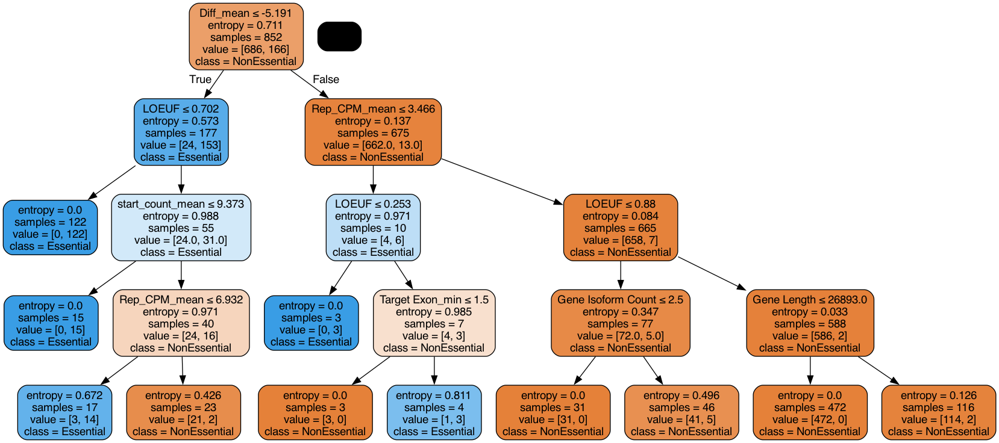

In [124]:
# Visualize Tree
dot_data = StringIO()

tree.export_graphviz(dtree_no_exp_model, out_file=dot_data,
                     filled=True, rounded=True,
                     special_characters=True, feature_names=X_mini_train_mean_no_exp.columns, class_names=['NonEssential', 'Essential'])
graph=pydotplus.graph_from_dot_data(dot_data.getvalue())
Image(graph.create_png())

Tuned_model - no expression
Accuracy: 0.9765258215962441
Balanced accuracy: 0.9390243902439024
              precision    recall  f1-score   support

           0       0.97      1.00      0.99       172
           1       1.00      0.88      0.94        41

    accuracy                           0.98       213
   macro avg       0.99      0.94      0.96       213
weighted avg       0.98      0.98      0.98       213



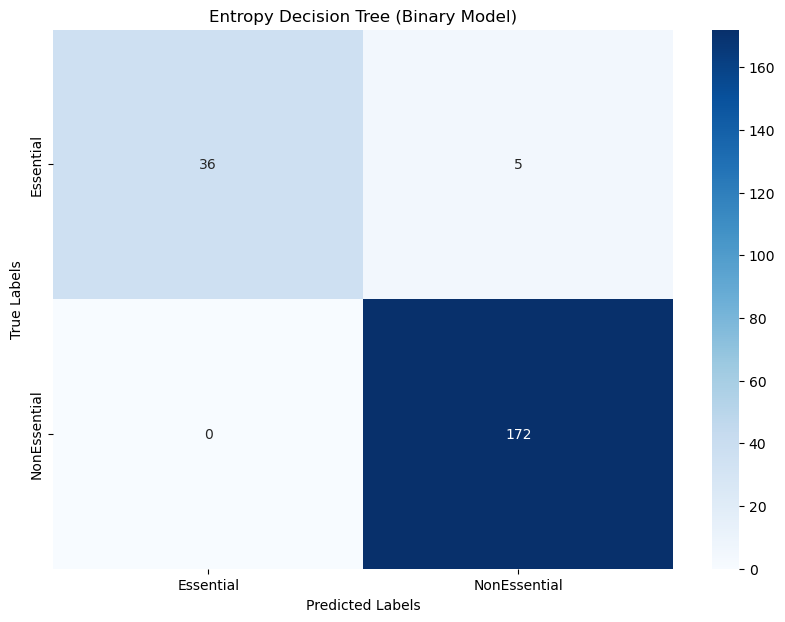

In [125]:
# Run this block for model evaluation metrics 
print("Tuned_model - no expression")
print("Accuracy:", metrics.accuracy_score(y_mini_test, dtree_no_exp_y_pred))
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_mini_test, dtree_no_exp_y_pred))
print(metrics.classification_report(y_mini_test, dtree_no_exp_y_pred))

 # Define the mapping from numerical values to string labels
label_mapping = {0: 'NonEssential', 1: 'Essential'}

# Map the numerical values to string labels
mini_y_test_mapped = y_mini_test.map(label_mapping)
mini_y_pred_mapped = pd.Series(dtree_no_exp_y_pred).map(label_mapping)

# Calculate the confusion matrix
conf_matrix = metrics.confusion_matrix(mini_y_test_mapped, mini_y_pred_mapped)

# Get the unique class labels
class_labels = ['Essential', 'NonEssential']

# Plot the confusion matrix
#fig = plt.figure(figsize=(10, 7))
#sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
#plt.xlabel('Predicted Labels')
#plt.ylabel('True Labels')
#plt.title("Entropy Confusion Matrix: Binary Model (mean)")
fig = create_plot_confusion_matrix(y_mini_test, dtree_no_exp_y_pred, f'Entropy Decision Tree (Binary Model)', binary='yes')
plt.show()

#print features importances
feat=dtree_no_exp_model.feature_importances_
# Create a DataFrame to display the feature importances
feature_importances_df = pd.DataFrame({
    'Feature': X_mini_test_mean_no_exp.columns,
    'Importance': feat
}).sort_values(by='Importance', ascending=False)

# Display the feature importances
show(feature_importances_df)   

# Try Trac1 on model

In [65]:
trac1_df=pd.read_csv('../data/processed/brunello_trac1_gene_level_data.csv')
show(trac1_df)

In [66]:
trac1_df=calculate_ratio(trac1_df, 'Tx Length', 'Target Exon_min', 'TargetEx2TxLength')
# Rename columns
#trac1_df.rename(columns={'A375 mean': 'cell_exp_mean', 'A375 median': 'cell_exp_median', 'A375 std_dev': 'cell_exp_std_dev'}, inplace=True)
trac1_df.rename(columns={'A375 mean': 'cell_exp_mean', 'A375 median': 'cell_exp_median', 'A375 std_dev': 'cell_exp_std_dev',
                        'trac1_pDNA_CPM_mean': 'start_count_mean', 'trac1_pDNA_CPM_median': 'start_count_median',
                        'trac1_pDNA_CPM_std': 'start_count_std'}, inplace=True)
# Display the updated dataframe
show(trac1_df.head())

In [67]:
print(trac1_df.columns)

Index(['Target Gene ID', 'start_count_mean', 'start_count_median',
       'start_count_std', 'trac1_RepA_CPM_mean', 'trac1_RepA_CPM_median',
       'trac1_RepA_CPM_std', 'trac1_RepB_CPM_mean', 'trac1_RepB_CPM_median',
       'trac1_RepB_CPM_std', 'trac1_A_diff_mean', 'trac1_A_diff_median',
       'trac1_A_diff_std', 'trac1_B_diff_mean', 'trac1_B_diff_median',
       'trac1_B_diff_std', 'Target Exon_min', 'Tx Length',
       'Gene Isoform Count', 'Gene Length', 'cell_exp_mean', 'cell_exp_median',
       'cell_exp_std_dev', 'LOEUF', 'Annotation', 'TargetEx2TxLength'],
      dtype='object')


In [68]:
# Calculate the median of the three specified columns for each row- take the median for each value
trac1_df=aggregate_reps(trac1_df, 'Rep_CPM_mean', ['trac1_RepA_CPM_mean', 'trac1_RepB_CPM_mean'])
trac1_df=aggregate_reps(trac1_df, 'Rep_CPM_median', ['trac1_RepA_CPM_median', 'trac1_RepB_CPM_median'])
trac1_df=aggregate_reps(trac1_df, 'Rep_CPM_std', ['trac1_RepA_CPM_std', 'trac1_RepB_CPM_std'])
trac1_df=aggregate_reps(trac1_df, 'Diff_mean', ['trac1_A_diff_mean', 'trac1_B_diff_mean'])
trac1_df=aggregate_reps(trac1_df, 'Diff_median', ['trac1_A_diff_median', 'trac1_B_diff_median'])
trac1_df=aggregate_reps(trac1_df, 'Diff_std', ['trac1_A_diff_std', 'trac1_B_diff_std'])

# Display the updated dataframe
show(trac1_df.head())

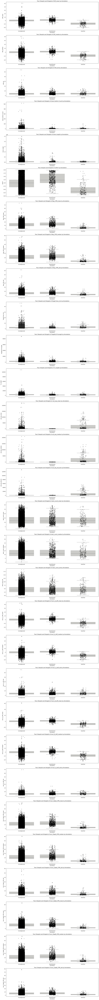

In [69]:
# List of numerical columns excluding 'Target Gene ID'
numerical_columns = trac1_df.select_dtypes(include=[np.number]).columns.tolist()
numerical_columns.remove('Target Gene ID')
numerical_columns.sort()

# Set up the figure
fig, axes = plt.subplots(len(numerical_columns), 1, figsize=(15, 5 * len(numerical_columns)))

# Plot each numerical column
for i, col in enumerate(numerical_columns):
    sns.boxplot(x='Annotation', y=col, data=trac1_df, ax=axes[i], color="#9B9B93", boxprops=dict(alpha=0.5))
    sns.stripplot(x='Annotation', y=col, data=trac1_df, ax=axes[i], color='black', alpha=0.5, jitter=True)
    axes[i].set_title(f'Trac1 Boxplot and Stripplot of {col} by Annotation')

plt.tight_layout()
plt.show()

In [70]:
# Convert 'Annotation' column to numerical values
annotation_mapping = {'Uncategorized': -1, 'NonEssential': 0, 'Essential': 1}
trac1_df['Annotation'] = trac1_df['Annotation'].map(annotation_mapping)

# Display the updated dataframe
show(trac1_df)

In [71]:
#trac1_df['start_count_mean_decile'] = pd.qcut(trac1_df['start_count_mean'], 10, labels=False) + 1
#trac1_df['exp_mean_decile'] = pd.qcut(trac1_df['cell_exp_mean'], 10, labels=False) + 1

In [72]:
#just noticed I need to correct the NaN in TargetEx2TxLenth
trac1_df['TargetEx2TxLength']=trac1_df['TargetEx2TxLength'].fillna(0)
trac1_df.isna().sum()

Target Gene ID           0
start_count_mean         0
start_count_median       0
start_count_std          1
trac1_RepA_CPM_mean      0
trac1_RepA_CPM_median    0
trac1_RepA_CPM_std       1
trac1_RepB_CPM_mean      0
trac1_RepB_CPM_median    0
trac1_RepB_CPM_std       1
trac1_A_diff_mean        0
trac1_A_diff_median      0
trac1_A_diff_std         1
trac1_B_diff_mean        0
trac1_B_diff_median      0
trac1_B_diff_std         1
Target Exon_min          0
Tx Length                0
Gene Isoform Count       0
Gene Length              0
cell_exp_mean            0
cell_exp_median          0
cell_exp_std_dev         0
LOEUF                    0
Annotation               0
TargetEx2TxLength        0
Rep_CPM_mean             0
Rep_CPM_median           0
Rep_CPM_std              1
Diff_mean                0
Diff_median              0
Diff_std                 1
dtype: int64

In [73]:
#fill remaining null values with 0
trac1_df = trac1_df.fillna(0)
trac1_df.isna().sum()

Target Gene ID           0
start_count_mean         0
start_count_median       0
start_count_std          0
trac1_RepA_CPM_mean      0
trac1_RepA_CPM_median    0
trac1_RepA_CPM_std       0
trac1_RepB_CPM_mean      0
trac1_RepB_CPM_median    0
trac1_RepB_CPM_std       0
trac1_A_diff_mean        0
trac1_A_diff_median      0
trac1_A_diff_std         0
trac1_B_diff_mean        0
trac1_B_diff_median      0
trac1_B_diff_std         0
Target Exon_min          0
Tx Length                0
Gene Isoform Count       0
Gene Length              0
cell_exp_mean            0
cell_exp_median          0
cell_exp_std_dev         0
LOEUF                    0
Annotation               0
TargetEx2TxLength        0
Rep_CPM_mean             0
Rep_CPM_median           0
Rep_CPM_std              0
Diff_mean                0
Diff_median              0
Diff_std                 0
dtype: int64

In [74]:
trac1_df = trac1_df.drop(columns=trac1_df.filter(regex='^trac1_').columns)
show(trac1_df)

In [75]:
# Drop rows where 'Annotation' is 'Uncategorized'
mini_trac1_df = trac1_df[trac1_df['Annotation'] != -1]
show(mini_trac1_df)

In [76]:
mini_trac1_df=mini_trac1_df.set_index('Target Gene ID')
show(mini_trac1_df.head())

- Diff_median
- Diff_std
- exp_mean_decile
- start_count_mean_decile

In [77]:
X_mini_trac1_df=mini_trac1_df.drop(columns=['Annotation', 'cell_exp_median', 'cell_exp_std_dev', 'Rep_CPM_median', 'Rep_CPM_std', 
                                            'start_count_median', 'start_count_std', 'Diff_median', 'Diff_std'])
y_mini_trac1_df=mini_trac1_df['Annotation']
show(X_mini_trac1_df.head())
show(y_mini_trac1_df.head())

In [78]:
#predict trac1 using 'optimized model'
dtree_trac1_y_pred = dtree_model.predict(X_mini_trac1_df)
#turn into a series
dtree_trac1_y_pred = pd.Series(dtree_trac1_y_pred)

Tuned Decision Tree Model on New Data
Accuracy: 0.9943661971830986
Balanced accuracy: 0.9873399547312591
              precision    recall  f1-score   support

           0       0.99      1.00      1.00       858
           1       1.00      0.98      0.99       207

    accuracy                           0.99      1065
   macro avg       0.99      0.99      0.99      1065
weighted avg       0.99      0.99      0.99      1065



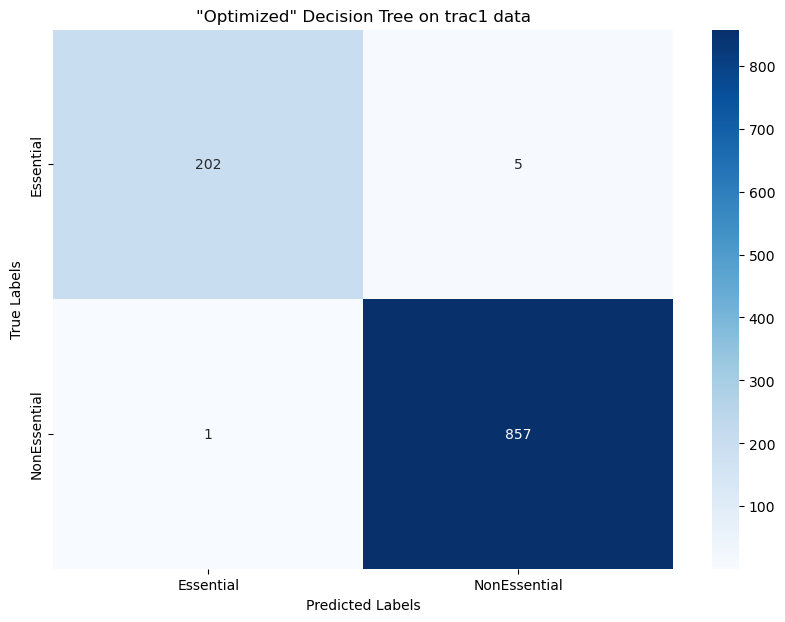

In [79]:
# Run this block for model evaluation metrics 
print("Tuned Decision Tree Model on New Data")
print("Accuracy:", metrics.accuracy_score(y_mini_trac1_df, dtree_trac1_y_pred))
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_mini_trac1_df, dtree_trac1_y_pred))
print(metrics.classification_report(y_mini_trac1_df, dtree_trac1_y_pred))

 # Define the mapping from numerical values to string labels
label_mapping = {0: 'NonEssential', 1: 'Essential'}

# Map the numerical values to string labels
y_trac1_test_mapped = y_mini_trac1_df.map(label_mapping)
y_trac1_pred_mapped = pd.Series(dtree_trac1_y_pred).map(label_mapping)

# Calculate the confusion matrix
conf_matrix = metrics.confusion_matrix(y_trac1_test_mapped, y_trac1_pred_mapped)
# Get the unique class labels
class_labels = ['Essential', 'NonEssential']
#print(len(y_mini_trac1_df))
#print(len(dtree_trac1_y_pred))
# Plot the confusion matrix
#fig = plt.figure(figsize=(10, 7))
#sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
#plt.xlabel('Predicted Labels')
#plt.ylabel('True Labels')
#plt.title("Optimized Decision Tree on trac1 data")
fig = create_plot_confusion_matrix(y_mini_trac1_df, dtree_trac1_y_pred, f'"Optimized" Decision Tree on trac1 data', binary='yes')
plt.show()

In [80]:
X_mini_trac1_results=X_mini_trac1_df.copy()
X_mini_trac1_results['annots']=y_trac1_test_mapped
X_mini_trac1_results['pred']=y_trac1_pred_mapped.values
X_mini_trac1_results['correct'] = (X_mini_trac1_results['annots']==X_mini_trac1_results['pred'])
show(X_mini_trac1_results)

In [81]:
opt_trac1_model_wrong_df = X_mini_trac1_results[X_mini_trac1_results['correct'] == False].copy()
opt_trac1_model_wrong_df['Model']="Optimized"
show(opt_trac1_model_wrong_df)

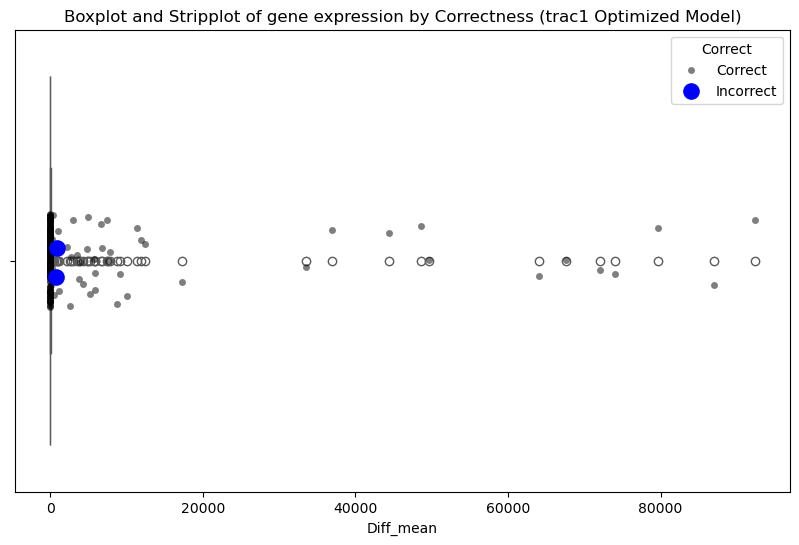

In [82]:
# Set up the figure
plt.figure(figsize=(10, 6))

# Create the boxplot
sns.boxplot(x='cell_exp_mean', data=X_mini_test_results, color="#9B9B93", boxprops=dict(alpha=0.5))

# Create the stripplot for correct=True
sns.stripplot(x='cell_exp_mean', data=X_mini_test_results[X_mini_test_results['correct'] == True], color='black', alpha=0.5, jitter=True, label='Correct')

# Create the stripplot for correct=False with larger dots
sns.stripplot(x='cell_exp_mean', data=X_mini_test_results[X_mini_test_results['correct'] == False], color='blue', alpha=1, jitter=True, size=12, label='Incorrect')

# Set the title and labels
plt.title('Boxplot and Stripplot of gene expression by Correctness (trac1 Optimized Model)')
plt.xlabel('Diff_mean')
plt.ylabel('')

# Show the legend
plt.legend(title='Correct', loc='upper right')

# Show the plot
plt.show()

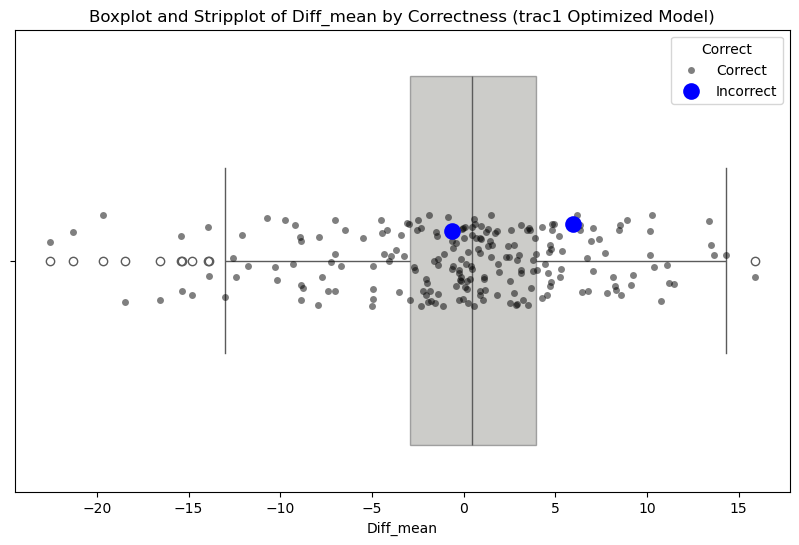

In [83]:
# Set up the figure
plt.figure(figsize=(10, 6))

# Create the boxplot
sns.boxplot(x='Diff_mean', data=X_mini_test_results, color="#9B9B93", boxprops=dict(alpha=0.5))

# Create the stripplot for correct=True
sns.stripplot(x='Diff_mean', data=X_mini_test_results[X_mini_test_results['correct'] == True], color='black', alpha=0.5, jitter=True, label='Correct')

# Create the stripplot for correct=False with larger dots
sns.stripplot(x='Diff_mean', data=X_mini_test_results[X_mini_test_results['correct'] == False], color='blue', alpha=1, jitter=True, size=12, label='Incorrect')

# Set the title and labels
plt.title('Boxplot and Stripplot of Diff_mean by Correctness (trac1 Optimized Model)')
plt.xlabel('Diff_mean')
plt.ylabel('')

# Show the legend
plt.legend(title='Correct', loc='upper right')

# Show the plot
plt.show()

In [84]:
#also try unoptimized gini model
#predict
gini_trac1_y_pred = gini_nonopt_model.predict(X_mini_trac1_df)
#turn into a series
gini_trac1_y_pred = pd.Series(gini_trac1_y_pred)

Untuned Gini Decision Tree Model on Trac1 data
Accuracy: 0.9971830985915493
Balanced accuracy: 0.9982517482517482
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       858
           1       0.99      1.00      0.99       207

    accuracy                           1.00      1065
   macro avg       0.99      1.00      1.00      1065
weighted avg       1.00      1.00      1.00      1065



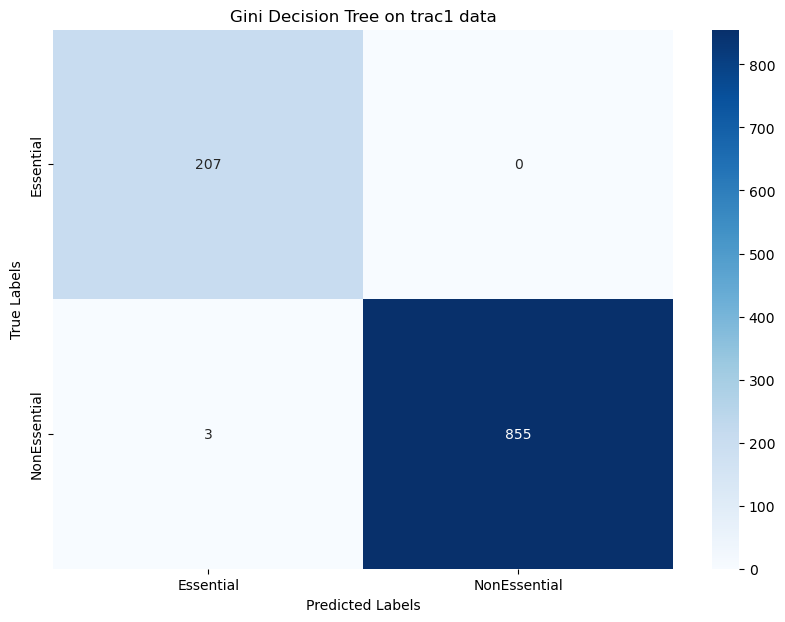

In [85]:
# Run this block for model evaluation metrics 
print("Untuned Gini Decision Tree Model on Trac1 data")
print("Accuracy:", metrics.accuracy_score(y_mini_trac1_df, gini_trac1_y_pred))
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_mini_trac1_df, gini_trac1_y_pred))
print(metrics.classification_report(y_mini_trac1_df, gini_trac1_y_pred))


 # Define the mapping from numerical values to string labels
label_mapping = {0: 'NonEssential', 1: 'Essential'}

# Map the numerical values to string labels
y_gini_test_mapped = y_mini_trac1_df.map(label_mapping)
y_gini_pred_mapped = pd.Series(gini_trac1_y_pred).map(label_mapping)

# Calculate the confusion matrix
gini_conf_matrix = metrics.confusion_matrix(y_gini_test_mapped, y_gini_pred_mapped)

# Get the unique class labels
class_labels = ['Essential', 'NonEssential']

# Plot the confusion matrix
#fig = plt.figure(figsize=(10, 7))
#sns.heatmap(gini_conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
#plt.xlabel('Predicted Labels')
#plt.ylabel('True Labels')
#plt.title("Unoptimized Gini Decision Tree on trac1 data")
fig = create_plot_confusion_matrix(y_mini_trac1_df, gini_trac1_y_pred, f'Gini Decision Tree on trac1 data', binary='yes')
plt.show()

In [86]:
X_mini_trac1_gini_results=X_mini_trac1_df.copy()
X_mini_trac1_gini_results['annots']=y_gini_test_mapped
X_mini_trac1_gini_results['pred']=y_gini_pred_mapped.values
X_mini_trac1_gini_results['correct'] = (X_mini_trac1_gini_results['annots']==X_mini_trac1_gini_results['pred'])
show(X_mini_trac1_gini_results)

In [87]:
gini_trac1_model_wrong_df = X_mini_trac1_gini_results[X_mini_trac1_gini_results['correct'] == False].copy()
gini_trac1_model_wrong_df['Model']="Gini"
show(gini_trac1_model_wrong_df)

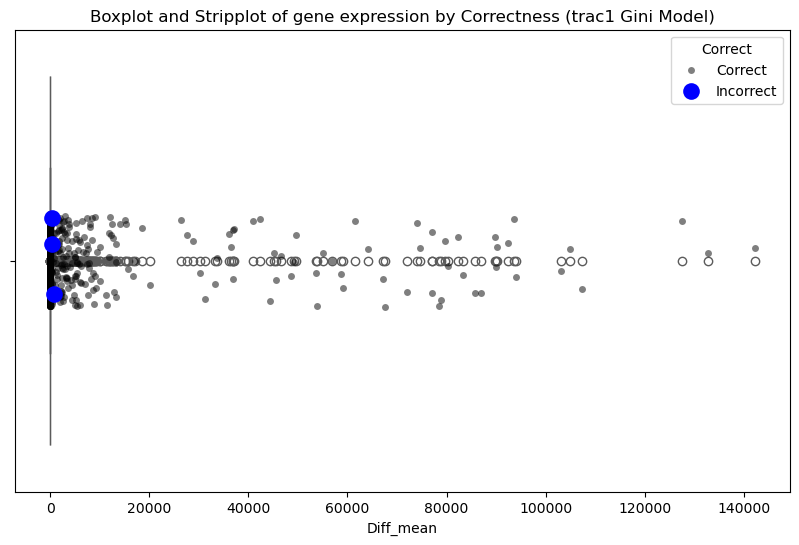

In [88]:
# Set up the figure
plt.figure(figsize=(10, 6))

# Create the boxplot
sns.boxplot(x='cell_exp_mean', data=X_mini_trac1_gini_results, color="#9B9B93", boxprops=dict(alpha=0.5))

# Create the stripplot for correct=True
sns.stripplot(x='cell_exp_mean', data=X_mini_trac1_gini_results[X_mini_trac1_gini_results['correct'] == True], color='black', alpha=0.5, jitter=True, label='Correct')

# Create the stripplot for correct=False with larger dots
sns.stripplot(x='cell_exp_mean', data=X_mini_trac1_gini_results[X_mini_trac1_gini_results['correct'] == False], color='blue', alpha=1, jitter=True, size=12, label='Incorrect')

# Set the title and labels
plt.title('Boxplot and Stripplot of gene expression by Correctness (trac1 Gini Model)')
plt.xlabel('Diff_mean')
plt.ylabel('')

# Show the legend
plt.legend(title='Correct', loc='upper right')

# Show the plot
plt.show()

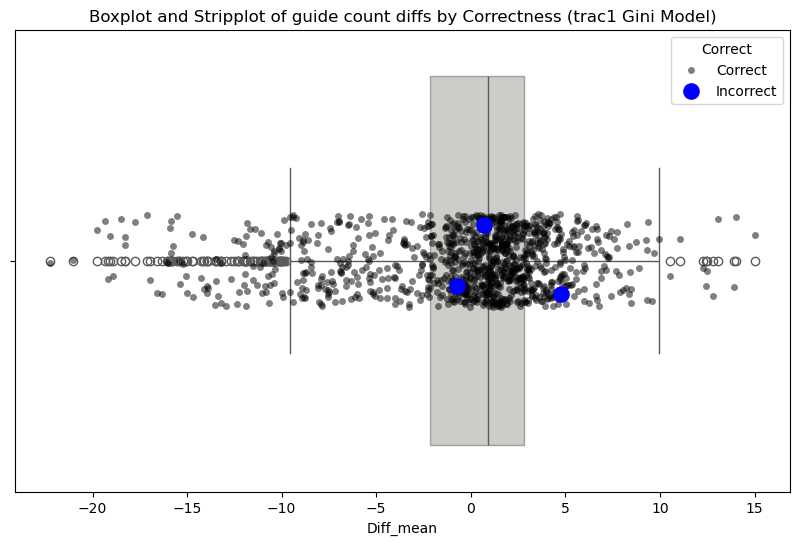

In [89]:
# Set up the figure
plt.figure(figsize=(10, 6))

# Create the boxplot
sns.boxplot(x='Diff_mean', data=X_mini_trac1_gini_results, color="#9B9B93", boxprops=dict(alpha=0.5))

# Create the stripplot for correct=True
sns.stripplot(x='Diff_mean', data=X_mini_trac1_gini_results[X_mini_trac1_gini_results['correct'] == True], color='black', alpha=0.5, jitter=True, label='Correct')

# Create the stripplot for correct=False with larger dots
sns.stripplot(x='Diff_mean', data=X_mini_trac1_gini_results[X_mini_trac1_gini_results['correct'] == False], color='blue', alpha=1, jitter=True, size=12, label='Incorrect')

# Set the title and labels
plt.title('Boxplot and Stripplot of guide count diffs by Correctness (trac1 Gini Model)')
plt.xlabel('Diff_mean')
plt.ylabel('')

# Show the legend
plt.legend(title='Correct', loc='upper right')

# Show the plot
plt.show()

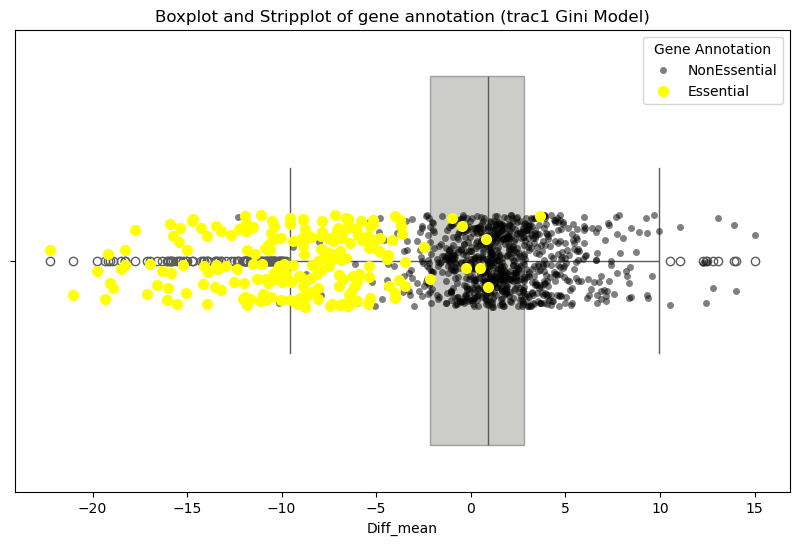

In [90]:
# Set up the figure
plt.figure(figsize=(10, 6))

# Create the boxplot
sns.boxplot(x='Diff_mean', data=X_mini_trac1_gini_results, color="#9B9B93", boxprops=dict(alpha=0.5))

# Create the stripplot for correct=True
sns.stripplot(x='Diff_mean', data=X_mini_trac1_gini_results[X_mini_trac1_gini_results['annots'] == 'NonEssential'], color='black', alpha=0.5, jitter=True, label='NonEssential')

# Create the stripplot for correct=False with larger dots
sns.stripplot(x='Diff_mean', data=X_mini_trac1_gini_results[X_mini_trac1_gini_results['annots'] == 'Essential'], color='yellow', alpha=1, jitter=True, size=8, label='Essential')

# Set the title and labels
plt.title('Boxplot and Stripplot of gene annotation (trac1 Gini Model)')
plt.xlabel('Diff_mean')
plt.ylabel('')

# Show the legend
plt.legend(title='Gene Annotation', loc='upper right')

# Show the plot
plt.show()

In [91]:
#try binary model: mini_entr_nonopt_model
#predict
bin_trac1_y_pred = mini_entr_nonopt_model.predict(X_mini_trac1_df)
#turn into a series
bin_trac1_y_pred = pd.Series(bin_trac1_y_pred)

Untuned Entropy Decision Tree Model on Trac1 data
Accuracy: 0.9981220657276996
Balanced accuracy: 0.9988344988344988
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       858
           1       0.99      1.00      1.00       207

    accuracy                           1.00      1065
   macro avg       1.00      1.00      1.00      1065
weighted avg       1.00      1.00      1.00      1065



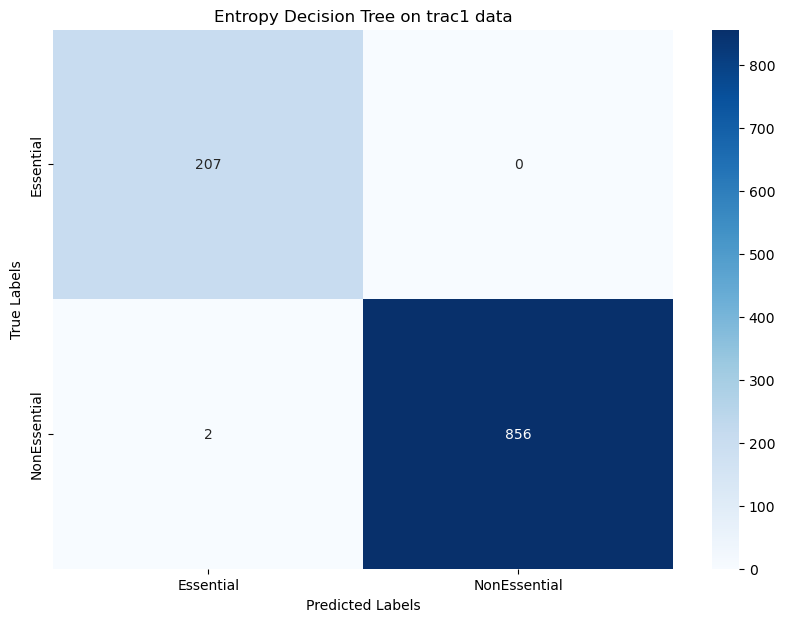

In [92]:
# Run this block for model evaluation metrics 
print("Untuned Entropy Decision Tree Model on Trac1 data")
print("Accuracy:", metrics.accuracy_score(y_mini_trac1_df, bin_trac1_y_pred))
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_mini_trac1_df, bin_trac1_y_pred))
print(metrics.classification_report(y_mini_trac1_df, bin_trac1_y_pred))


 # Define the mapping from numerical values to string labels
label_mapping = {0: 'NonEssential', 1: 'Essential'}

# Map the numerical values to string labels
y_bin_test_mapped = y_mini_trac1_df.map(label_mapping)
y_bin_pred_mapped = pd.Series(bin_trac1_y_pred).map(label_mapping)

# Calculate the confusion matrix
gini_conf_matrix = metrics.confusion_matrix(y_bin_test_mapped, y_bin_pred_mapped)

# Get the unique class labels
class_labels = ['Essential', 'NonEssential']

# Plot the confusion matrix
#fig = plt.figure(figsize=(10, 7))
#sns.heatmap(gini_conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
#plt.xlabel('Predicted Labels')
#plt.ylabel('True Labels')
#plt.title("Unoptimized Gini Decision Tree on trac1 data")
fig = create_plot_confusion_matrix(y_mini_trac1_df, bin_trac1_y_pred, f'Entropy Decision Tree on trac1 data', binary='yes')
plt.show()

In [93]:
X_mini_trac1_bin_results=X_mini_trac1_df.copy()
X_mini_trac1_bin_results['annots']=y_bin_test_mapped
X_mini_trac1_bin_results['pred']=y_bin_pred_mapped.values
X_mini_trac1_bin_results['correct'] = (X_mini_trac1_bin_results['annots']==X_mini_trac1_bin_results['pred'])
show(X_mini_trac1_bin_results)



In [94]:
bin_trac1_model_wrong_df = X_mini_trac1_bin_results[X_mini_trac1_bin_results['correct'] == False].copy()
bin_trac1_model_wrong_df['Model']="Entropy"
show(bin_trac1_model_wrong_df)

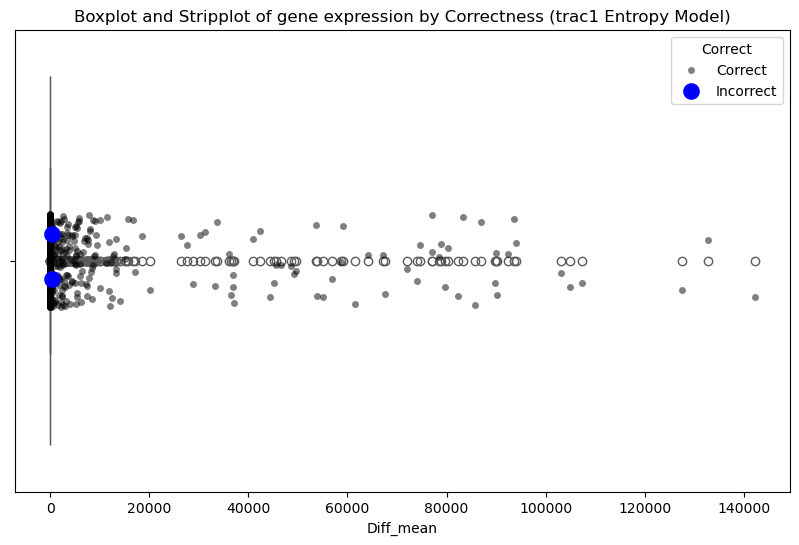

In [95]:
# Set up the figure
plt.figure(figsize=(10, 6))

# Create the boxplot
sns.boxplot(x='cell_exp_mean', data=X_mini_trac1_bin_results, color="#9B9B93", boxprops=dict(alpha=0.5))

# Create the stripplot for correct=True
sns.stripplot(x='cell_exp_mean', data=X_mini_trac1_bin_results[X_mini_trac1_bin_results['correct'] == True], color='black', alpha=0.5, jitter=True, label='Correct')

# Create the stripplot for correct=False with larger dots
sns.stripplot(x='cell_exp_mean', data=X_mini_trac1_bin_results[X_mini_trac1_bin_results['correct'] == False], color='blue', alpha=1, jitter=True, size=12, label='Incorrect')

# Set the title and labels
plt.title('Boxplot and Stripplot of gene expression by Correctness (trac1 Entropy Model)')
plt.xlabel('Diff_mean')
plt.ylabel('')

# Show the legend
plt.legend(title='Correct', loc='upper right')

# Show the plot
plt.show()

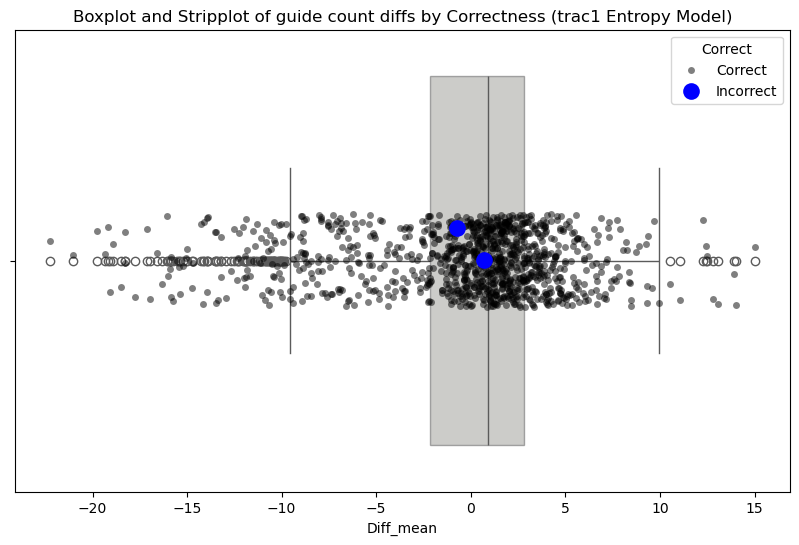

In [96]:
# Set up the figure
plt.figure(figsize=(10, 6))

# Create the boxplot
sns.boxplot(x='Diff_mean', data=X_mini_trac1_bin_results, color="#9B9B93", boxprops=dict(alpha=0.5))

# Create the stripplot for correct=True
sns.stripplot(x='Diff_mean', data=X_mini_trac1_bin_results[X_mini_trac1_bin_results['correct'] == True], color='black', alpha=0.5, jitter=True, label='Correct')

# Create the stripplot for correct=False with larger dots
sns.stripplot(x='Diff_mean', data=X_mini_trac1_bin_results[X_mini_trac1_bin_results['correct'] == False], color='blue', alpha=1, jitter=True, size=12, label='Incorrect')

# Set the title and labels
plt.title('Boxplot and Stripplot of guide count diffs by Correctness (trac1 Entropy Model)')
plt.xlabel('Diff_mean')
plt.ylabel('')

# Show the legend
plt.legend(title='Correct', loc='upper right')

# Show the plot
plt.show()

In [130]:
#remove gene expression
X_mini_trac1_no_exp_df=X_mini_trac1_df.drop(columns=['cell_exp_mean'])

In [131]:
#dtree_no_exp_model
#predict
dtree_no_exp_trac1_y_pred = dtree_no_exp_model.predict(X_mini_trac1_no_exp_df)
#turn into a series
dtree_no_exp_trac1_y_pred = pd.Series(dtree_no_exp_trac1_y_pred)

Tuned Decision Tree No Expression Model on Trac1 data
Accuracy: 0.9746478873239437
Balanced accuracy: 0.9421134421134421
              precision    recall  f1-score   support

           0       0.97      1.00      0.98       858
           1       0.98      0.89      0.93       207

    accuracy                           0.97      1065
   macro avg       0.98      0.94      0.96      1065
weighted avg       0.97      0.97      0.97      1065



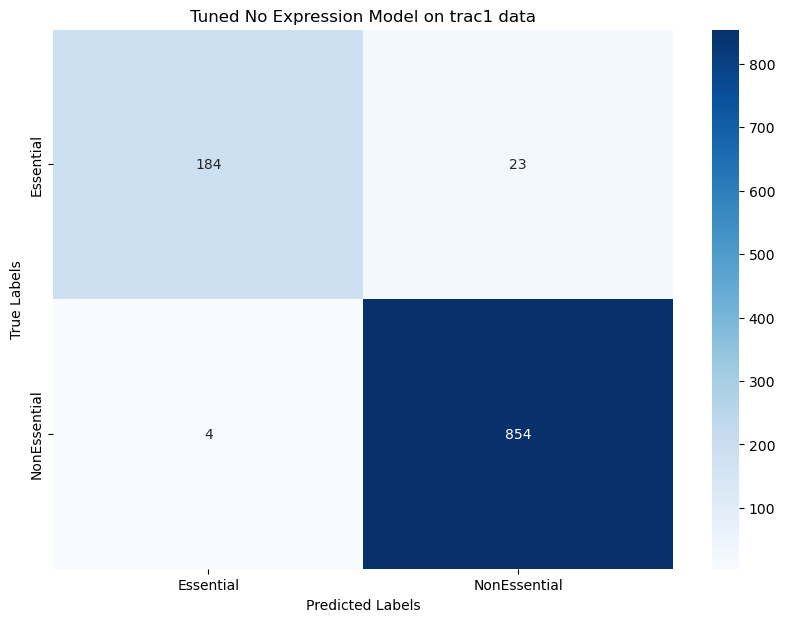

In [134]:
# Run this block for model evaluation metrics 
print("Tuned Decision Tree No Expression Model on Trac1 data")
print("Accuracy:", metrics.accuracy_score(y_mini_trac1_df, dtree_no_exp_trac1_y_pred))
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_mini_trac1_df, dtree_no_exp_trac1_y_pred))
print(metrics.classification_report(y_mini_trac1_df, dtree_no_exp_trac1_y_pred))


 # Define the mapping from numerical values to string labels
label_mapping = {0: 'NonEssential', 1: 'Essential'}

# Map the numerical values to string labels
y_bin_test_mapped = y_mini_trac1_df.map(label_mapping)
y_bin_pred_mapped = pd.Series(dtree_no_exp_trac1_y_pred).map(label_mapping)

# Calculate the confusion matrix
gini_conf_matrix = metrics.confusion_matrix(y_bin_test_mapped, y_bin_pred_mapped)

# Get the unique class labels
class_labels = ['Essential', 'NonEssential']

# Plot the confusion matrix
#fig = plt.figure(figsize=(10, 7))
#sns.heatmap(gini_conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
#plt.xlabel('Predicted Labels')
#plt.ylabel('True Labels')
#plt.title("Unoptimized Gini Decision Tree on trac1 data")
fig = create_plot_confusion_matrix(y_mini_trac1_df, dtree_no_exp_trac1_y_pred, f'Tuned No Expression Model on trac1 data', binary='yes')
plt.show()

In [138]:
X_mini_trac1_no_exp_results=X_mini_trac1_no_exp_df.copy()
X_mini_trac1_no_exp_results['annots']=y_bin_test_mapped
X_mini_trac1_no_exp_results['pred']=y_bin_pred_mapped.values
X_mini_trac1_no_exp_results['correct'] = (X_mini_trac1_no_exp_results['annots']==X_mini_trac1_no_exp_results['pred'])
show(X_mini_trac1_no_exp_results)

In [139]:
no_exp_trac1_model_wrong_df = X_mini_trac1_no_exp_results[X_mini_trac1_no_exp_results['correct'] == False].copy()
no_exp_trac1_model_wrong_df['Model']="Tuned-NoExp"
show(no_exp_trac1_model_wrong_df)

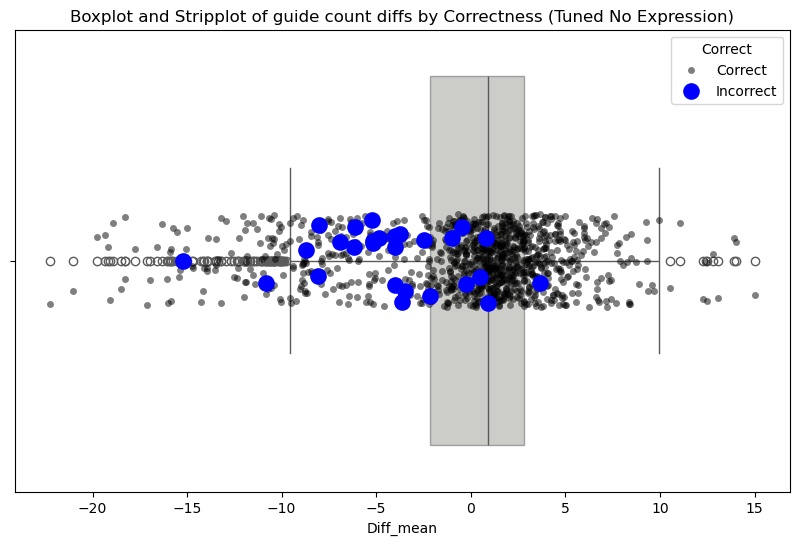

In [140]:
# Set up the figure
plt.figure(figsize=(10, 6))

# Create the boxplot
sns.boxplot(x='Diff_mean', data=X_mini_trac1_no_exp_results, color="#9B9B93", boxprops=dict(alpha=0.5))

# Create the stripplot for correct=True
sns.stripplot(x='Diff_mean', data=X_mini_trac1_no_exp_results[X_mini_trac1_no_exp_results['correct'] == True], color='black', alpha=0.5, jitter=True, label='Correct')

# Create the stripplot for correct=False with larger dots
sns.stripplot(x='Diff_mean', data=X_mini_trac1_no_exp_results[X_mini_trac1_no_exp_results['correct'] == False], color='blue', alpha=1, jitter=True, size=12, label='Incorrect')

# Set the title and labels
plt.title('Boxplot and Stripplot of guide count diffs by Correctness (Tuned No Expression)')
plt.xlabel('Diff_mean')
plt.ylabel('')

# Show the legend
plt.legend(title='Correct', loc='upper right')

# Show the plot
plt.show()

# Look at Misclassifications

In [141]:
# Concatenate the three dataframes
combined_df = pd.concat([opt_trac1_model_wrong_df, gini_trac1_model_wrong_df, bin_trac1_model_wrong_df, no_exp_trac1_model_wrong_df], axis=0)
combined_df=combined_df.reset_index()
# Display the combined dataframe
show(combined_df)

In [142]:
# Drop all columns except the specified ones
combined_df = combined_df[['Target Gene ID', 'Model', 'Diff_mean', 'cell_exp_mean', 'annots', 'pred', 'correct']]

# Display the updated dataframe
show(combined_df)

In [143]:
mini_comb=combined_df[['Target Gene ID', 'Model']].copy()
show(mini_comb)

In [144]:
# Group by 'Model' and aggregate 'Target Gene ID' into lists
model_gene_ids = mini_comb.groupby('Model')['Target Gene ID'].apply(list).to_dict()

# Display the result
print(model_gene_ids)


{'Entropy': [8153, 113878], 'Gini': [4109, 8153, 113878], 'Optimized': [3104, 4109, 5565, 11019, 55756, 196383], 'Tuned-NoExp': [3104, 4670, 5128, 5565, 5682, 7064, 7528, 8106, 8175, 8559, 8774, 10240, 10291, 10847, 10920, 24144, 53371, 54433, 55559, 55756, 91283, 129868, 153443, 196383, 286380, 404785, 441521]}


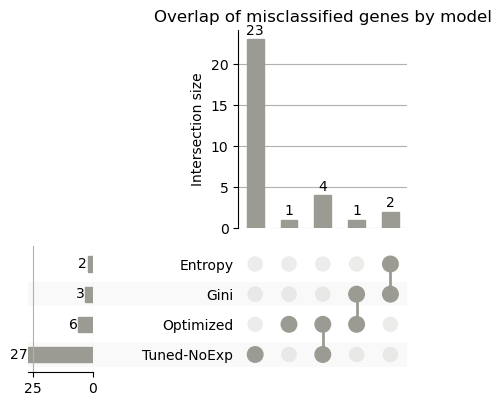

In [145]:

import warnings
warnings.filterwarnings('ignore')
#make upsetplot first
#make a dictionary from named tuple to give to upsetplot
fig = plt.figure(figsize=(20,20))
#pmid_dict={q.query: list(q.pid_set) for q in pmids_sets}
data = upsetplot.from_contents(model_gene_ids)
#print(data)
upsetplot.plot(data,show_counts=True, facecolor="#9B9B93", fig=fig)
plt.title("Overlap of misclassified genes by model")
#plt.savefig('upset_plot.png', dpi=300)
plt.show()

# Conclusion

Model generalizes pretty well on a different data set using the same cell line expression. 